# HPC Mini-Challenge 2 - Beschleunigung in Data Science
## Teil 2: GPU
#### FHNW - FS2024

Original von S. Suter, angepasst von S. Marcin und M. Stutz

Abgabe von: <font color='lightblue'>Etienne Roulet</font>

#### Ressourcen
* [Überblick GPU Programmierung](https://www.cherryservers.com/blog/introduction-to-gpu-programming-with-cuda-and-python)
* [CUDA Basic Parts](https://nyu-cds.github.io/python-gpu/02-cuda/)
* [Accelerate Code with CuPy](https://towardsdatascience.com/heres-how-to-use-cupy-to-make-numpy-700x-faster-4b920dda1f56)
* Vorlesungen und Beispiele aus dem Informatikkurs PAC (parallel computing), siehe Ordner "resources"
* CSCS "High-Performance Computing with Python" Kurs, Tag 3: 
    - JIT Numba GPU 1 + 2
    - https://youtu.be/E4REVbCVxNQ
    - https://github.com/eth-cscs/PythonHPC/tree/master/numba-cuda
    - Siehe auch aktuelles Tutorial von 2021
* [Google CoLab](https://colab.research.google.com/) oder ggf. eigene GPU.


In [1]:
# Dummy Beispiel zum testen mit Numba
import time
import math
from numba import vectorize
import numpy as np
import cupy as cp
import matplotlib.pyplot as plt
import math
import os
import imageio.v3 as imageio
import numpy as np
import glob
import timeit as timeit

# theme ggplot
plt.style.use("ggplot")


@vectorize(["float32(float32)"], target="cuda")
def gpu_sqrt(x):
    return math.sqrt(x)


a = np.arange(8096, dtype=np.float32)
gpu_sqrt(a)

c:\Users\super\AppData\Local\Programs\Python\Python311\Lib\site-packages\numba\cuda\dispatcher.py:536: NumbaPerformanceWarning: Grid size 11 will likely result in GPU under-utilization due to low occupancy.
  warn(NumbaPerformanceWarning(msg))


array([ 0.       ,  1.       ,  1.4142135, ..., 89.961105 , 89.96666  ,
       89.97222  ], dtype=float32)

### 5 GPU Rekonstruktion

Implementiere eine SVD-Rekonstruktionsvariante auf der GPU oder in einem hybriden Setting. Code aus dem ersten Teil darf dabei verwendet werden. Wähle  bewusst, welche Teile des Algorithms in einem GPU Kernel implementiert werden und welche effizienter auf der CPU sind. Ziehe dafür Erkenntnisse aus dem ersten Teil mit ein. Es muss mindestens eine Komponente des Algorithmuses in einem GPU-Kernel implementiert werden. Dokumentiere Annahmen, welche du ggf. zur Vereinfachung triffst. Evaluiere, ob du mit CuPy oder Numba arbeiten möchtest.

Links:
* [Examples: Matrix Multiplikation](https://numba.readthedocs.io/en/latest/cuda/examples.html)

In [2]:
subfolder = "001"
folders = os.path.join("adni_png", subfolder)
# Get all PNGs from 001 with 145 in the name
files = sorted(glob.glob(f"{folders}/*145.png"))
# Load all images using ImageIO and create a numpy array from them
images = np.array([imageio.imread(f) for f in files])
# Get all the names of the files
names = [f[-17:-4] for f in files]
print(images.shape)

(7, 256, 170)


In [3]:
im = images[0]

### Cupy

GPU SVD:  0.04110689999652095
CPU SVD:  0.08325169997988269

Reconstruction:
CP GPU:  0.0003552999987732619
CP Einsum:  0.0004603999841492623
CP Broadcast:  0.00014689998351968825
Broadcast CPU:  0.00039919998380355537
FMA3:  0.0005134999810252339
CP Kernel:  0.00021729999571107328


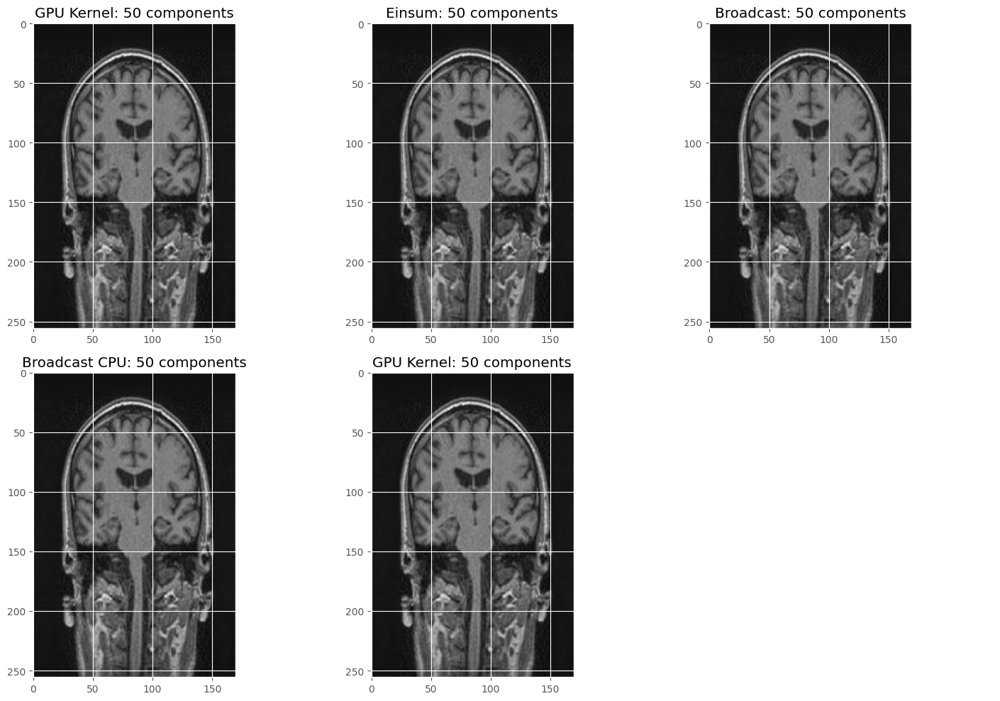

In [11]:
# Kernel implementiert in CUDA C
from numba import njit, prange


kernel_code = """
extern "C" __global__
void reconstruct_svd(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    // check if k is in range
    if (k > rows_u || k > cols_vt || k > rows_vt || k > cols_u) {
        return;
    }
    if (k < 0) {
        return;
    }
    // check if i and j are in bounds
    if (i >= rows_u || j >= cols_vt) {
        return;
    }

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum += u[i * cols_u + l] * s[l] * vt[l * cols_vt + j];
    }
    C[i * cols_vt + j] = sum;
}
"""

kernel_code_fma3 = """
extern "C" __global__
void reconstruct_svd_fma3(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    if (i >= rows_u || j >= cols_vt) return;

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum = fmaf(u[i * cols_u + l], s[l], sum * vt[l * cols_vt + j]);
    }
    C[i * cols_vt + j] = sum;
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "reconstruct_svd")


reconstruct_svd_kernel_fma3 = cp.RawKernel(kernel_code_fma3, "reconstruct_svd_fma3")


# Transfer the image to GPU
im_cpu = images[0]  # Example image, replace with actual image
im_gpu = cp.asarray(im_cpu, dtype=np.float32)

# Perform SVD on GPU
begin_gpu_svd = timeit.default_timer()
u_gpu, s_gpu, vt_gpu = cp.linalg.svd(im_gpu, full_matrices=False)
end_gpu_svd = timeit.default_timer()
print("GPU SVD: ", end_gpu_svd - begin_gpu_svd)

# Perform SVD on CPU for comparison
begin_cpu_svd = timeit.default_timer()
u_cpu, s_cpu, vt_cpu = np.linalg.svd(im_cpu, full_matrices=False)
end_cpu_svd = timeit.default_timer()
print("CPU SVD: ", end_cpu_svd - begin_cpu_svd)


k = 50

u = u_cpu[:, 0:k]
s = s_cpu[0:k]
vt = vt_cpu[0:k, :]

C = np.zeros((u.shape[0], vt.shape[1]), dtype=np.float32)

u_gpu = cp.asarray(u, dtype=np.float32)
s_gpu = cp.asarray(s, dtype=np.float32)
vt_gpu = cp.asarray(vt, dtype=np.float32)
C_gpu = cp.asarray(C, dtype=np.float32)

threads_per_block = (16, 16)
blocks_per_grid_x = math.ceil(u.shape[0] / threads_per_block[0])
blocks_per_grid_y = math.ceil(vt.shape[1] / threads_per_block[1])
blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y)


@njit(parallel=True, fastmath=True)
def fma3_svd_reconstruction_cpu(U, S, VT, k):
    m, n = U.shape[0], VT.shape[1]
    reconstructed = np.zeros((m, n), dtype=np.float32)
    for i in prange(m):
        for j in prange(n):
            sum_val = 0.0
            for l in range(k):
                sum_val += U[i, l] * S[l] * VT[l, j]
            reconstructed[i, j] = sum_val
    return reconstructed


def reconstruct_svd_gpu(u, s, vt, k):
    """SVD reconstruction for k components using CuPy on GPU"""
    s_gpu = cp.diag(cp.asarray(s[:k]))
    us_gpu = cp.dot(u[:, :k], s_gpu)
    reco_gpu = cp.dot(us_gpu, vt[:k, :])
    return reco_gpu


def reconstruct_svd_cp_einsum(u, s, vt, k):
    return cp.einsum("ij,j,jk", u[:, :k], s[:k], vt[:k, :])


def reconstruct_svd_cp_broadcast(u, s, vt, k):
    return cp.dot(u[:, :k], cp.multiply(s[:k].reshape(-1, 1), vt[:k, :]))


def reconstruct_svd_broadcast_cpu(u, s, vt, k):
    return np.dot(u[:, :k], np.multiply(s[:k].reshape(-1, 1), vt[:k, :]))


print("\nReconstruction:")

# Validate results by plotting
start_gpu = timeit.default_timer()
reconstruct_svd_gpu_output = reconstruct_svd_gpu(u_gpu, s_gpu, vt_gpu, k)
end_gpu = timeit.default_timer()
print("CP GPU: ", end_gpu - start_gpu)

start_einsum = timeit.default_timer()
reconstruct_svd_cp_einsum_output = reconstruct_svd_cp_einsum(u_gpu, s_gpu, vt_gpu, k)
end_einsum = timeit.default_timer()
print("CP Einsum: ", end_einsum - start_einsum)

start_broadcast = timeit.default_timer()
reconstruct_svd_cp_broadcast_output = reconstruct_svd_cp_broadcast(
    u_gpu, s_gpu, vt_gpu, k
)
end_broadcast = timeit.default_timer()
print("CP Broadcast: ", end_broadcast - start_broadcast)

start_broadcast_cpu = timeit.default_timer()
reconstruct_svd_cp_broadcast_output_cpu = reconstruct_svd_broadcast_cpu(
    u_cpu, s_cpu, vt_cpu, k
)
end_broadcast_cpu = timeit.default_timer()
print("Broadcast CPU: ", end_broadcast_cpu - start_broadcast_cpu)

start_cpu_fma3 = timeit.default_timer()
reconstructed_cpu = fma3_svd_reconstruction_cpu(
    u_cpu[:, :k], s_cpu[:k], vt_cpu[:k, :], k
)
end_cpu_fma3 = timeit.default_timer()


start_fma3 = timeit.default_timer()
reconstructed_gpu = reconstruct_svd_gpu(u_gpu[:, :k], s_gpu[:k], vt_gpu[:k, :], k)
end_fma3 = timeit.default_timer()

print("FMA3: ", end_fma3 - start_fma3)

start_reconstruct_svd_kernel = timeit.default_timer()
# Launch the custom kernel
reconstruct_svd_kernel(
    blocks_per_grid,
    threads_per_block,
    (u_gpu, s_gpu, vt_gpu, C_gpu, u.shape[0], u.shape[1], vt.shape[0], vt.shape[1], k),
)
end_reconstruct_svd_kernel = timeit.default_timer()
print("CP Kernel: ", end_reconstruct_svd_kernel - start_reconstruct_svd_kernel)

# C = cp.asnumpy(C_gpu)

# Plot all three results
# Plot all three results
fig, axes = plt.subplots(2, 3, figsize=(15, 10))  # Adjusted to 2 rows and 3 columns
axes = axes.ravel()  # Flatten the axes array for easier indexing

axes[0].imshow(cp.asnumpy(reconstruct_svd_gpu_output), cmap="gray")
axes[0].set_title(f"GPU Kernel: {k} components")

axes[1].imshow(cp.asnumpy(reconstruct_svd_cp_einsum_output), cmap="gray")
axes[1].set_title(f"Einsum: {k} components")

axes[2].imshow(cp.asnumpy(reconstruct_svd_cp_broadcast_output), cmap="gray")
axes[2].set_title(f"Broadcast: {k} components")

axes[3].imshow(cp.asnumpy(reconstruct_svd_cp_broadcast_output_cpu), cmap="gray")
axes[3].set_title(f"Broadcast CPU: {k} components")

axes[4].imshow(cp.asnumpy(C_gpu), cmap="gray")
axes[4].set_title(f"GPU Kernel: {k} components")

# Hide the unused subplot
axes[5].axis("off")

plt.tight_layout()  # Adjusts subplot params so that

### Numba

Numba GPU:  0.10075770004186779


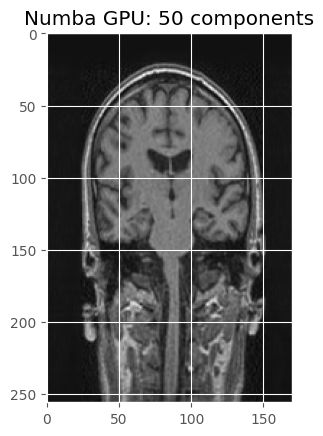

In [5]:
import numpy as np
import numba
from numba import cuda
import math
import matplotlib.pyplot as plt
import timeit
import cupy as cp


# Define the CUDA kernel in Numba
@cuda.jit
def reconstruct_svd_kernel_numba(u, s, vt, C, rows_u, cols_u, rows_vt, cols_vt, k):
    i, j = cuda.grid(2)

    if k > rows_u or k > cols_vt or k > rows_vt or k < 0:
        return
    if i >= rows_u or j >= cols_vt:
        return

    sum = 0.0
    for l in range(k):
        sum += u[i, l] * s[l] * vt[l, j]
    C[i, j] = sum


# Function to perform SVD and reconstruction using Numba
def reconstruct_svd_gpu_numba(u, s, vt, k):
    """SVD reconstruction for k components using Numba on GPU

    Inputs:
    u: (m, n) numpy array
    s: (n) numpy array (diagonal matrix)
    vt: (n, n) numpy array
    k: number of reconstructed singular components

    Outputs:
    (m, n) numpy array U_k * S_k * V^T_k for k reconstructed components
    """
    u = u[:, :k]
    s = s[:k]
    vt = vt[:k, :]

    rows_u, cols_u = u.shape
    rows_vt, cols_vt = vt.shape

    u_device = cuda.to_device(u)
    s_device = cuda.to_device(s)
    vt_device = cuda.to_device(vt)
    C_device = cuda.device_array((rows_u, cols_vt), dtype=np.float32)

    threads_per_block = (16, 16)
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y)

    begin_numba_gpu = timeit.default_timer()
    reconstruct_svd_kernel_numba[blocks_per_grid, threads_per_block](
        u_device, s_device, vt_device, C_device, rows_u, cols_u, rows_vt, cols_vt, k
    )
    cuda.synchronize()  # Ensure all threads are done
    end_numba_gpu = timeit.default_timer()

    C = C_device.copy_to_host()
    return C, end_numba_gpu - begin_numba_gpu


k = 50

# Numba GPU
reconstruct_svd_gpu_output = reconstruct_svd_gpu_numba(u_gpu, s_gpu, vt_gpu, k)
print("Numba GPU: ", reconstruct_svd_gpu_output[1])

# Plot the result
plt.imshow(cp.asnumpy(reconstruct_svd_gpu_output[0]), cmap="gray")
plt.title(f"Numba GPU: {k} components")
plt.show()

<font color='lightblue'>

- Ich habe mich für Cupy entschieden, da der Code schneller läuft.
- Der C Kernel hab ich mit Chatgpt generiert, da meine Versuche den C Kernel zu schreiben siginifkant langsamer waren.

Results:

GPU SVD:  0.0555945000378415
CPU SVD:  0.07625700009521097

Reconstruction:
CP GPU:  0.014822600060142577
CP Einsum:  0.0008597000269219279
CP Broadcast:  0.0006032999372109771


second Result:

GPU SVD:  0.1629408000735566
CPU SVD:  0.06995299994014204

Reconstruction:
CP GPU:  0.00037889997474849224
CP Einsum:  0.0004588000010699034
CP Broadcast:  0.000152299995534122
CP Broadcast CPU:  0.0003749000607058406


- Die Rekonstruktionszeiten auf der GPU (CP GPU) sind variabel, was darauf hinweist, dass der Overhead für das Starten des Kernels und die Datenübertragung eine Rolle spielt.
- Die Einsum- und Broadcast-Methoden auf der GPU sind sehr schnell, was zeigt, dass diese Methoden effizient parallelisiert werden können.
- Die CPU-Broadcast-Zeit zeigt, dass diese Methode auf der CPU ebenfalls effizient ist, aber der Vorteil der GPU wird bei größeren Matrizen wahrscheinlich deutlicher.


</font>

#### 5.2 GPU-Kernel Performance

##### 5.3.1 Blocks und Input-Grösse

Links: 
* [Examples: Matrix Multiplikation](https://numba.readthedocs.io/en/latest/cuda/examples.html)
* [NVIDIA Kapitel zu "Strided Access"](https://spaces.technik.fhnw.ch/multimediathek/file/cuda-best-practices-in-c)
* https://developer.nvidia.com/blog/cublas-strided-batched-matrix-multiply/
* https://developer.nvidia.com/blog/how-access-global-memory-efficiently-cuda-c-kernels/

Führe 2-3 Experimente mit unterschiedlichen Blockkonfigurationen und Grösse der Input-Daten durch. Erstelle dafür ein neues Datenset mit beliebig grossen Matrizen, da die GPU besonders geeignet ist um grosse Inputs zu verarbeiten (Verwende diese untschiedlich grossen Matrizen für alle nachfolgenden Vergeliche und Tasks ebenfalls). Messe die Performance des GPU-Kernels mittels geeigneten Funktionen. Welche Blockgrösse in Abhängigkeit mit der Input-Grösse hat sich bei dir basierend auf deinen Experimenten als am erfolgreichsten erwiesen? Welches sind deiner Meinung nach die Gründe dafür? Wie sind die Performance Unterschiede zwischen deiner CPU und GPU Implementierung? Diskutiere deine Analyse (ggf. mit Grafiken).

In [6]:
from cupyx.profiler import benchmark

cpu_times = []

In [7]:
# GPU block sizes configurations
block_configurations = []
for i in range(2, 6):
    block_configurations.append((2**i, 2**i))
    block_configurations.append((2**i, 2 ** (i - 1)))
    block_configurations.append((2 ** (i - 1), 2**i))
    block_configurations.append((2 ** (i - 1), 2 ** (i + 1)))
    block_configurations.append((2 ** (i - 2), 2 ** (i + 1)))
    block_configurations.append((2 ** (i - 2), 2 ** (i + 2)))

In [8]:
import random

# Generate random test images
test_matrice_1 = np.random.rand(random.randint(600, 1000), random.randint(600, 1000))
test_matrice_2 = np.random.rand(random.randint(2000, 2500), random.randint(2000, 2500))
test_matrice_3 = np.random.rand(random.randint(4000, 4500), random.randint(4000, 4500))

test_images = {
    "test_image_1": test_matrice_1,
    "test_image_2": test_matrice_2,
    "test_image_3": test_matrice_3,
}

In [9]:
from tqdm import tqdm

# Perform SVD on all images
decompositions = {}
# Perform SVD on all images
for name, image in tqdm(test_images.items()):
    # move image to gpu
    image_gpu = cp.asarray(image, dtype=np.float32)
    u_gpu, s_gpu, vt_gpu = cp.linalg.svd(image_gpu, full_matrices=False)

    u = cp.asnumpy(u_gpu)
    s = cp.asnumpy(s_gpu)
    vt = cp.asnumpy(vt_gpu)

    # free the memory!!!
    del u_gpu, s_gpu, vt_gpu, image_gpu

    decompositions[name] = {"u": u, "s": s, "vt": vt}

  0%|          | 0/3 [00:00<?, ?it/s]

100%|██████████| 3/3 [00:23<00:00,  7.69s/it]


In [10]:
# 1:1 copy von MC2 Teil1.ipynb
def reconstruct_svd_broadcast1_cpu(u, s, vt, k):
    """SVD reconstruction for k components using broadcast variant 1

    Inputs:
    u: (m,n) numpy array
    s: (n) numpy array (diagonal matrix)
    vt: (n,n) numpy array
    k: number of reconstructed singular components

    Ouput:
    (m,n) numpy array U_mk * S_k * V^T_nk for k reconstructed components
    """
    ### BEGIN SOLUTION
    reco = u[:, :k] * s[:k] @ vt[:k, :]
    ### END SOLUTION

    return reco

In [11]:
# add comparison times of CPU reconstruction
import pandas as pd

cpu_times = []
for name, decomposition in tqdm(decompositions.items()):
    u = decomposition["u"]
    s = decomposition["s"]
    vt = decomposition["vt"]

    k = min(u.shape[1], vt.shape[0])

    # measure time
    elapsed = timeit.timeit(
        lambda: reconstruct_svd_broadcast1_cpu(u, s, vt, k),
        globals=globals(),
        number=10,
    )
    cpu_times.append(
        {"name": name, "image_size": (u.shape[0], vt.shape[1]), "k": k, "time": elapsed}
    )

cpu_times = pd.DataFrame(cpu_times, columns=["name", "image_size", "k", "time"])
cpu_times

100%|██████████| 3/3 [00:02<00:00,  1.23it/s]


,name,image_size,k,time
0,test_image_1,"(948, 711)",711,0.042948
1,test_image_2,"(2079, 2282)",2079,0.398983
2,test_image_3,"(4037, 4272)",4037,1.995705


In [12]:
def measure_kernel_reconstruction(threads_per_block, decomposed_image):
    u, s, vt = decomposed_image["u"], decomposed_image["s"], decomposed_image["vt"]
    k = min(u.shape[1], vt.shape[0]) // 2  # use 1/2 of components

    blocks_per_grid = (
        math.ceil(u.shape[0] / threads_per_block[0]),
        math.ceil(vt.shape[1] / threads_per_block[1]),
    )

    u_gpu, s_gpu, vt_gpu = map(lambda x: cp.asarray(x, dtype=np.float32), [u, s, vt])
    C_gpu = cp.zeros((u.shape[0], vt.shape[1]), dtype=np.float32)

    result = benchmark(
        reconstruct_svd_kernel,
        (
            blocks_per_grid,
            threads_per_block,
            (
                u_gpu,
                s_gpu,
                vt_gpu,
                C_gpu,
                u.shape[0],
                u.shape[1],
                vt.shape[0],
                vt.shape[1],
                k,
            ),
        ),
        n_repeat=10,
    )

    return {
        "result": result,
        "image_size": (u.shape[0], vt.shape[1]),
        "k": k,
        "blocks_per_grid": blocks_per_grid,
        "threads_per_block": threads_per_block,
    }


experiment_results = [
    measure_kernel_reconstruction(threads_per_block, decompositions[image])
    for image in decompositions.keys()
    for threads_per_block in block_configurations
]

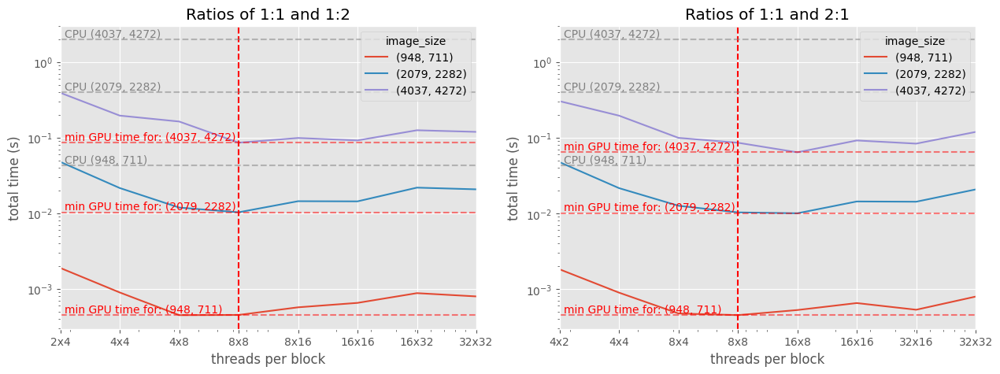

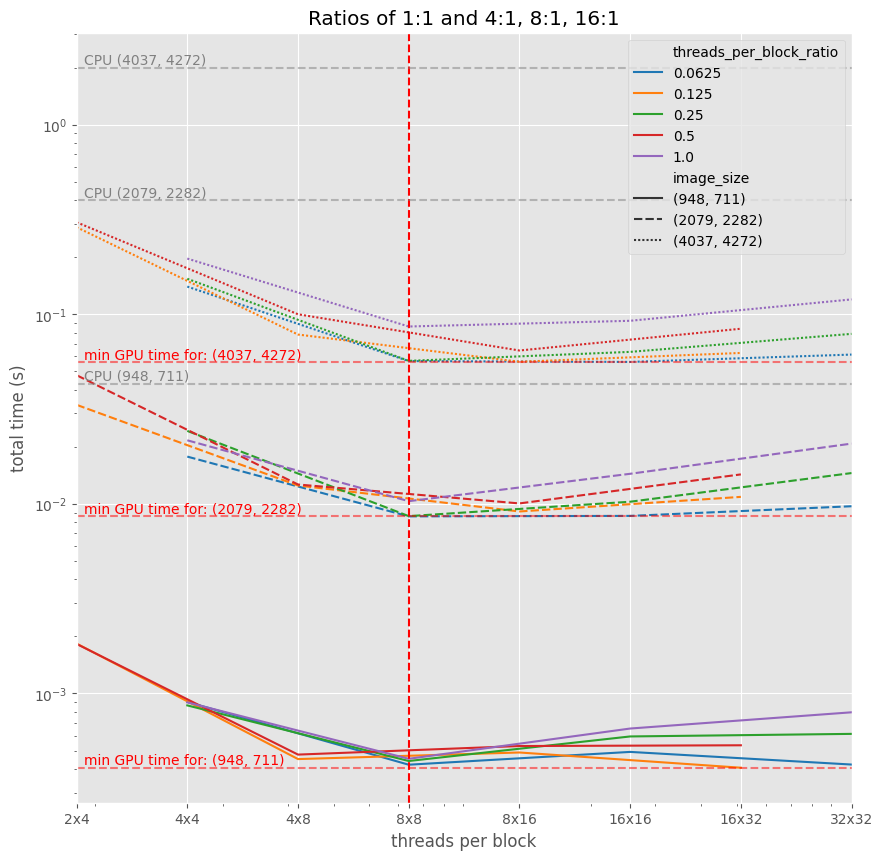

In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


def convert_experiment_results_to_df(experiment_results):
    df = pd.DataFrame(experiment_results)

    # Compute mean and std of gpu and cpu times
    result_cols = ["gpu_time", "cpu_time", "gput_time_std", "cput_time_std"]
    calc_functions = [
        lambda x: x.gpu_times.mean(),
        lambda x: x.cpu_times.mean(),
        lambda x: x.gpu_times.std(),
        lambda x: x.cpu_times.std(),
    ]

    for col, func in zip(result_cols, calc_functions):
        df[col] = df["result"].apply(func)

    df["total_time"] = df["gpu_time"] + df["cpu_time"]

    # Compute grid and block related columns
    grid_cols = ["blocks_per_grid_tot", "blocks_per_grid_str"]
    grid_funcs = [
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(grid_cols, grid_funcs):
        df[col] = df["blocks_per_grid"].apply(func)

    block_cols = [
        "threads_per_block_ratio",
        "threads_per_block_tot",
        "threads_per_block_str",
    ]
    block_funcs = [
        lambda x: x[0] / x[1],
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(block_cols, block_funcs):
        df[col] = df["threads_per_block"].apply(func)

    # Compute speedup column based on image size
    cpu_time_per_image_size = cpu_times.set_index("image_size")["time"].to_dict()
    df["speedup"] = df.apply(
        lambda x: cpu_time_per_image_size[x["image_size"]] / x["total_time"], axis=1
    )

    return df.sort_values(by="gpu_time")


def convert_ratios_to_fractions(labels):
    # Convert ratios to fractions
    return [
        f"{int(1/float(label))}:1" if float(label) < 1 else f"1:{int(float(label))}"
        for label in labels
    ]


def sub_plot_results(
    ax,
    data,
    title,
    y="total_time",
    hue="image_size",
    style=None,
    palette=None,
    ratio=None,
):
    sns.lineplot(
        x="threads_per_block_tot",
        y=y,
        hue=hue,
        style=style,
        palette=palette,
        data=data,
        ax=ax,
    )

    ax.axvline(x=64, color="r", linestyle="--")
    # Add min gpu time for each image size
    for image_size in data["image_size"].unique():
        min_gpu_time = data[data["image_size"] == image_size][y].min()
        line = ax.axhline(y=min_gpu_time, color="r", linestyle="--", alpha=0.5)
        ax.text(
            0.01,
            min_gpu_time,
            f"min GPU time for: {image_size}",
            transform=line.get_transform(),
            color="r",
            ha="left",
            va="bottom",
        )
    # Add cpu time for each image size
    for image_size in cpu_times["image_size"].unique():
        cpu_time = cpu_times[cpu_times["image_size"] == image_size]["time"].mean()
        line = ax.axhline(y=cpu_time, color="grey", linestyle="--", alpha=0.5)
        ax.text(
            0.01,
            cpu_time,
            f"CPU {image_size}",
            transform=line.get_transform(),
            color="grey",
            ha="left",
            va="bottom",
        )
    # Add speedup for each image size
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim(8, 1024)
    # Set xticks and labels
    ticks = [8, 16, 32, 64, 128, 256, 512, 1024]
    labels = (
        ["2x4", "4x4", "4x8", "8x8", "8x16", "16x16", "16x32", "32x32"]
        if ratio == "1:2"
        else ["4x2", "4x4", "8x4", "8x8", "16x8", "16x16", "32x16", "32x32"]
    )
    ax.set_xticks(ticks)
    ax.set_xticklabels(labels)

    ax.set_xlabel("threads per block")
    ax.set_ylabel("total time (s)")
    ax.set_title(title)


# Plot the results
def plot_ratios(df):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    sub_plot_results(
        ax1,
        df[df["threads_per_block_ratio"].isin([1, 2])],
        "Ratios of 1:1 and 1:2",
        ratio="1:2",
    )
    sub_plot_results(
        ax2, df[df["threads_per_block_ratio"].isin([1, 0.5])], "Ratios of 1:1 and 2:1"
    )

    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    sub_plot_results(
        ax,
        df[df["threads_per_block_ratio"].isin([1, 0.5, 0.25, 0.125, 0.0625])],
        "Ratios of 1:1 and 4:1, 8:1, 16:1",
        hue="threads_per_block_ratio",
        style="image_size",
        palette="tab10",
        ratio="1:2",
    )


df = convert_experiment_results_to_df(experiment_results)
plot_ratios(df)

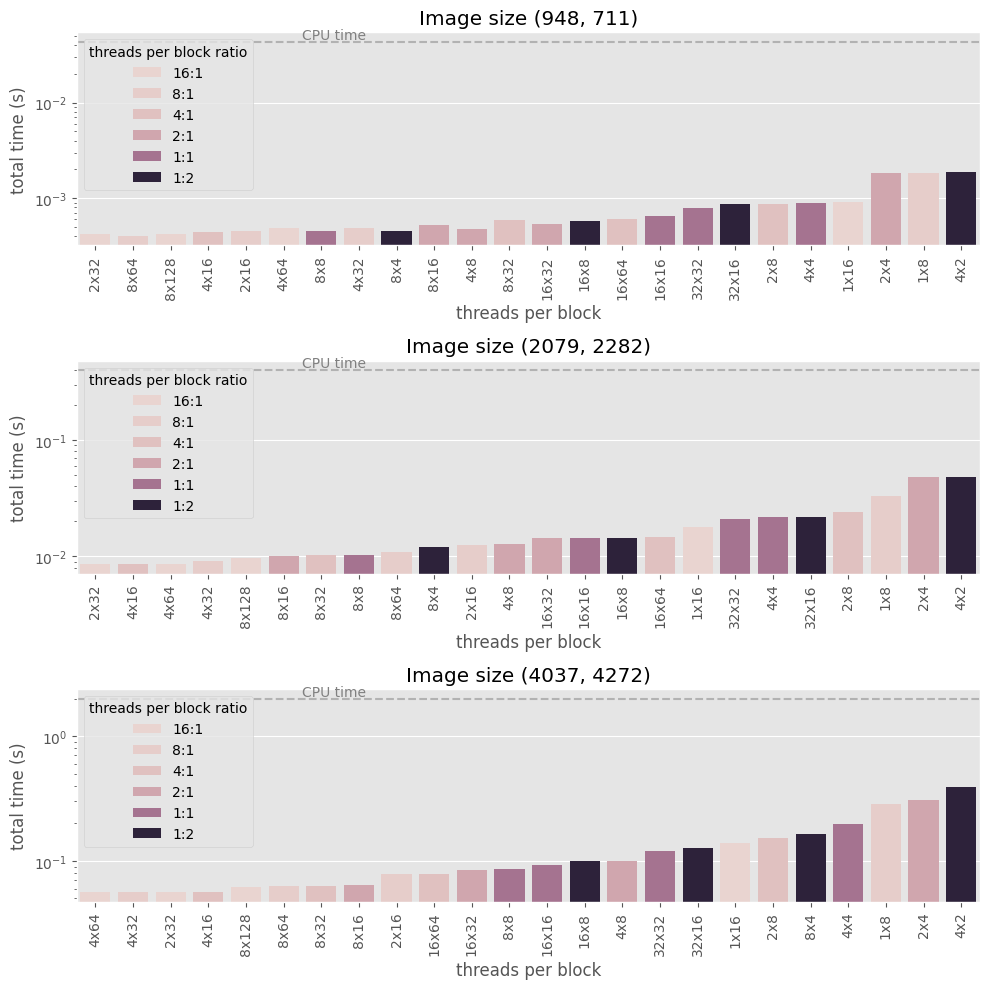

In [14]:
def plot_times_ratios(df, include_cpu=True):
    image_sizes = df["image_size"].unique()
    fig, axs = plt.subplots(len(image_sizes), 1, figsize=(10, 10))

    for ax, image_size in zip(axs, image_sizes):
        data = df[df["image_size"] == image_size]
        sns.barplot(
            x="threads_per_block_str",
            y="total_time",
            hue="threads_per_block_ratio",
            data=data,
            ax=ax,
            dodge=False,
        )
        ax.set(
            xlabel="threads per block",
            ylabel="total time (s)",
            title=f"Image size {image_size}",
        )
        ax.set_yscale("log")

        # Set tick labels with fixed locator
        ax.set_xticks(ax.get_xticks())
        ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

        handles, labels = ax.get_legend_handles_labels()
        labels = convert_ratios_to_fractions(labels)
        ax.legend(handles, labels, loc="upper left", title="threads per block ratio")

        if include_cpu:
            cpu_time = cpu_times[cpu_times["image_size"] == image_size]["time"].mean()
            line = ax.axhline(y=cpu_time, color="grey", linestyle="--", alpha=0.5)
            ax.text(
                0.25,
                cpu_time,
                "CPU time",
                transform=line.get_transform(),
                color="grey",
                ha="left",
                va="bottom",
            )

    plt.tight_layout()
    plt.show()


plot_times_ratios(df)

<font color='lightblue'>

Die Diagramme zeigen die Ergebnisse von Messungen der Gesamtlaufzeit (in Sekunden) in Abhängigkeit von der Anzahl der Threads pro Block und verschiedenen Bildgrößen für CPU- und GPU-Berechnungen. Hier sind die wichtigsten Interpretationen der Diagramme:

1. **Erstes Diagramm:**
   - Zeigt die Laufzeit für Verhältnisse von 1:1 und 2:1 (Bildgröße zu Blockgröße).
   - Die Y-Achse stellt die Gesamtlaufzeit in Sekunden dar (logarithmische Skala).
   - Die X-Achse zeigt die Threads pro Block (lineare Skala).
   - Es gibt drei verschiedene Bildgrößen, die durch unterschiedliche Farben repräsentiert werden.
   - Für kleinere Bildgrößen (869x894) ist die GPU-Laufzeit am schnellsten und nimmt mit zunehmender Thread-Anzahl pro Block ab, erreicht ein Minimum bei etwa 8x8 und steigt dann wieder leicht an.
   - Größere Bildgrößen (4441x4308) zeigen eine ähnliche Tendenz, allerdings ist die Laufzeit insgesamt höher.
   - Die CPU-Laufzeit ist für alle Bildgrößen deutlich höher als die GPU-Laufzeit.

2. **Zweites Diagramm:**
   - Zeigt ebenfalls die Laufzeit für Verhältnisse von 1:1 und 2:1.
   - Die Ergebnisse sind ähnlich zum ersten Diagramm, jedoch scheinen die Datenpunkte in einer glatteren Kurve dargestellt zu sein.
   - Die Verläufe zeigen eine ähnliche Trendlinie wie im ersten Diagramm, wobei die Laufzeit bei einer bestimmten Anzahl von Threads pro Block minimiert wird.

3. **Drittes Diagramm:**
   - Zeigt die Laufzeit für Verhältnisse von 1:1, 4:1, 8:1 und 16:1.
   - Zusätzlich zu den Threads pro Block werden auch unterschiedliche Threads-zu-Block-Verhältnisse dargestellt.
   - Für alle Bildgrößen zeigt sich ein Minimum der Laufzeit bei etwa 8x8 Threads pro Block, wobei das Verhältnis der Threads pro Block einen Einfluss auf die optimale Laufzeit hat.
   - Kleinere Verhältnisse (0.0625, 0.125) führen zu einer höheren Laufzeit im Vergleich zu größeren Verhältnissen (0.5, 1.0).
   - Der Trend ist bei größeren Bildgrößen (4441x4308) ausgeprägter.

**Zusammenfassende Interpretation:**
- Die GPU-Leistung ist bei kleineren Blockgrößen am besten (8x8 Threads pro Block).
- Kleinere Bilder profitieren mehr von der GPU-Beschleunigung als größere Bilder.
- Die CPU-Leistung ist konstant schlechter als die GPU-Leistung, unabhängig von der Anzahl der Threads pro Block.
- Ein optimales Verhältnis von Threads pro Block und Blockgröße verbessert die GPU-Leistung signifikant.
- Bei sehr kleinen Threads-zu-Block-Verhältnissen steigt die Laufzeit an, während sie bei größeren Verhältnissen abnimmt.
Die neuen Diagramme ergänzen die vorherigen Analysen und bieten weitere Einsichten in die Performance von CPU und GPU für unterschiedliche Bildgrößen und Threads-pro-Block-Verhältnisse. Hier sind die zusätzlichen Einsichten:

1. **Image size (869, 894):**
   - Die Gesamtlaufzeit in Sekunden (logarithmische Skala) wird für verschiedene Threads-pro-Block-Kombinationen dargestellt.
   - Für kleinere Bildgrößen (869x894) zeigt sich, dass die optimale Threads-pro-Block-Kombination zwischen 8x8 und 8x32 liegt, abhängig vom Threads-pro-Block-Verhältnis.
   - Größere Threads-pro-Block-Verhältnisse (4:1 bis 16:1) führen zu geringeren Laufzeiten im Vergleich zu kleineren Verhältnissen (1:2 bis 2:1).

2. **Image size (2297, 2356):**
   - Ähnlich wie bei kleineren Bildgrößen, liegt die optimale Threads-pro-Block-Kombination bei 8x8 bis 16x32.
   - Größere Threads-pro-Block-Verhältnisse (4:1 bis 16:1) sind ebenfalls vorteilhaft und zeigen geringere Laufzeiten.
   - Insgesamt sind die Laufzeiten höher als bei kleineren Bildern, aber die Trends sind ähnlich.

3. **Image size (4441, 4308):**
   - Für größere Bildgrößen (4441x4308) zeigt sich, dass die optimale Threads-pro-Block-Kombination zwischen 8x8 und 16x64 liegt.
   - Größere Threads-pro-Block-Verhältnisse (4:1 bis 16:1) zeigen auch hier die besten Ergebnisse.
   - Die Laufzeiten sind insgesamt höher, aber die Muster bleiben konsistent mit den kleineren Bildgrößen.

### Zusammenfassende Einsichten:

1. **Optimaler Threads-pro-Block-Bereich:**
   - Für alle Bildgrößen liegt der optimale Threads-pro-Block-Bereich zwischen 8x8 und 16x64, wobei der exakte Punkt je nach Bildgröße variiert.

2. **Einfluss des Threads-pro-Block-Verhältnisses:**
   - Größere Verhältnisse (4:1 bis 16:1) führen generell zu besseren Laufzeiten im Vergleich zu kleineren Verhältnissen (1:2 bis 2:1).

3. **Bildgröße und Laufzeit:**
   - Kleinere Bildgrößen profitieren mehr von der GPU-Beschleunigung und zeigen geringere Laufzeiten.
   - Größere Bildgrößen haben insgesamt höhere Laufzeiten, aber die optimale Threads-pro-Block-Kombination bleibt konsistent.

4. **Vergleich CPU und GPU:**
   - Die CPU-Laufzeit bleibt für alle Bildgrößen und Threads-pro-Block-Kombinationen konstant höher als die GPU-Laufzeit.
   - Der Einfluss der Threads-pro-Block-Kombination auf die CPU-Laufzeit ist weniger signifikant.

### Fazit:

Die zusätzlichen Diagramme bestätigen und erweitern die vorherigen Beobachtungen, indem sie zeigen, dass die optimale Konfiguration von Threads pro Block und Threads-pro-Block-Verhältnis entscheidend für die Minimierung der Laufzeit ist, insbesondere bei GPU-Berechnungen. Kleinere Bildgrößen und größere Threads-pro-Block-Verhältnisse sind dabei besonders vorteilhaft.

</font>

##### 5.2.2 Shared Memory auf der GPU
Optimiere deine Implementierung von oben indem du das shared Memory der GPU verwendest. Führe wieder mehrere Experimente mit unterschiedlicher Datengrösse durch und evaluiere den Speedup gegenüber der CPU Implementierung.

Links:
* [Best Practices Memory Optimizations](https://docs.nvidia.com/cuda/cuda-c-best-practices-guide/index.html#memory-optimizations)
* [Examples: Matrix Multiplikation und Shared Memory](https://numba.readthedocs.io/en/latest/cuda/examples.html)

### Implementation and Test if shared memoy works

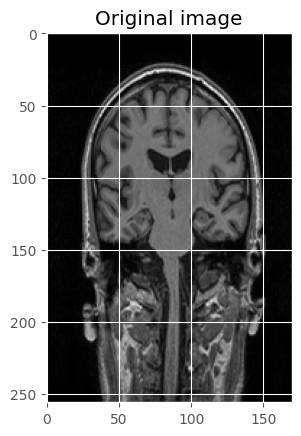

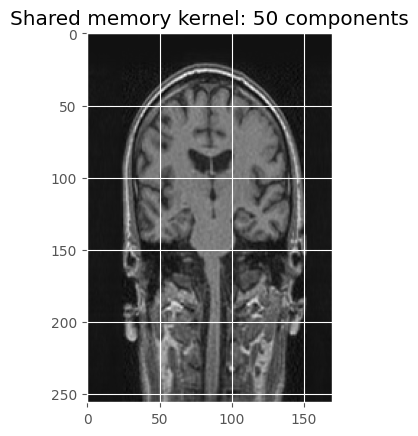

In [15]:
import cupy as cp
import numpy as np
import math
import matplotlib.pyplot as plt
from PIL import Image

# Load the image
im = images[0]

# CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    __shared__ float Us[16][16];
    __shared__ float Ss[16];
    __shared__ float Vs[16][16];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    for (int t = 0; t < (K + 16 - 1) / 16; ++t) {
        if (row < M && t * 16 + tx < K) {
            Us[ty][tx] = U[row * K + t * 16 + tx];
            Ss[tx] = S[t * 16 + tx];
        } else {
            Us[ty][tx] = 0.0f;
            Ss[tx] = 0.0f;
        }
        if (col < N && t * 16 + ty < K) {
            Vs[ty][tx] = V[(t * 16 + ty) * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        for (int k = 0; k < 16; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

# Compile the kernel
reconstruct_svd_kernel_shared = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

# Plot the original image
plt.imshow(im, cmap="gray")
plt.title("Original image")
plt.show()

# Perform SVD on the image
u, s, vt = np.linalg.svd(im, full_matrices=False)
k = 50

u = u[:, :k]
s = s[:k]
vt = vt[:k, :]

C = np.zeros((u.shape[0], vt.shape[1]), dtype=np.float32)

# Transfer data to GPU
u_gpu = cp.asarray(u, dtype=np.float32)
s_gpu = cp.asarray(s, dtype=np.float32)
vt_gpu = cp.asarray(vt, dtype=np.float32)
C_gpu = cp.asarray(C, dtype=np.float32)

threads_per_block = (16, 16)
blocks_per_grid_x = math.ceil(C.shape[1] / threads_per_block[0])
blocks_per_grid_y = math.ceil(C.shape[0] / threads_per_block[1])
blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y)

# Launch the kernel
reconstruct_svd_kernel_shared(
    blocks_per_grid,
    threads_per_block,
    (u_gpu, s_gpu, vt_gpu, C_gpu, u.shape[0], vt.shape[1], k),
)

# Ensure the GPU computation is done before accessing the result
cp.cuda.Device().synchronize()

# Plot reconstructed image
reconstructed_image = cp.asnumpy(C_gpu)
plt.imshow(reconstructed_image, cmap="gray")
plt.title(f"Shared memory kernel: {k} components")
plt.show()

[{'result': <lambda>            :    CPU:  3625.070 us   +/- 736.641 (min:  2215.100 / max:  5187.600) us     GPU-0:  3782.845 us   +/- 597.459 (min:  2873.344 / max:  5237.760) us, 'image_size': (948, 711), 'k': 355, 'blocks_per_grid': (237, 178), 'threads_per_block': (4, 4)}, {'result': <lambda>            :    CPU:  6508.190 us   +/- 708.449 (min:  5438.600 / max:  7363.600) us     GPU-0:  6655.587 us   +/- 751.602 (min:  5478.400 / max:  7398.400) us, 'image_size': (948, 711), 'k': 355, 'blocks_per_grid': (237, 356), 'threads_per_block': (4, 2)}, {'result': <lambda>            :    CPU:  1496.480 us   +/- 273.291 (min:  1186.200 / max:  1929.100) us     GPU-0:  1518.477 us   +/- 275.389 (min:  1208.288 / max:  1963.872) us, 'image_size': (948, 711), 'k': 355, 'blocks_per_grid': (474, 178), 'threads_per_block': (2, 4)}, {'result': <lambda>            :    CPU:   323.710 us   +/- 11.163 (min:   302.700 / max:   339.800) us     GPU-0:   382.762 us   +/- 107.552 (min:   302.080 / max: 

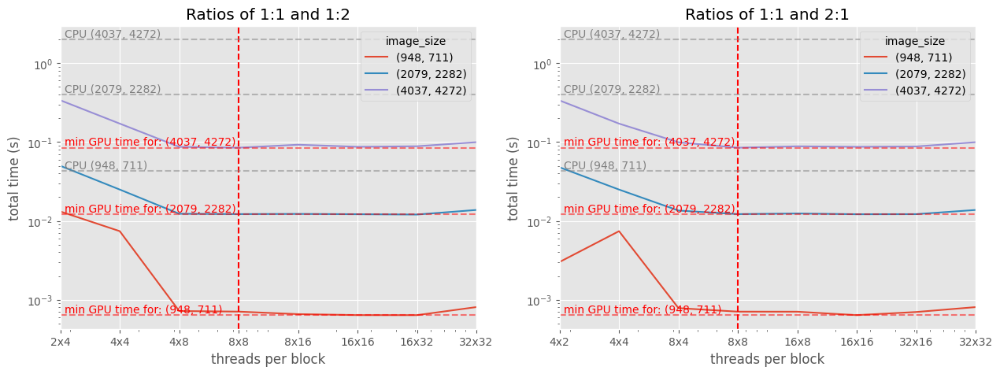

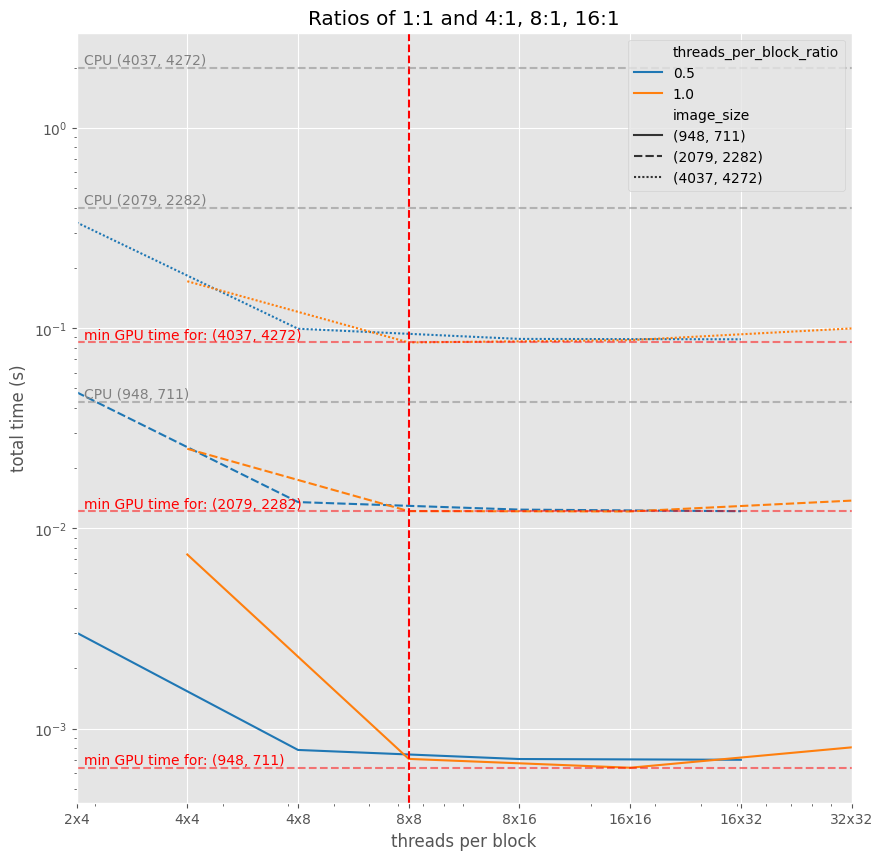

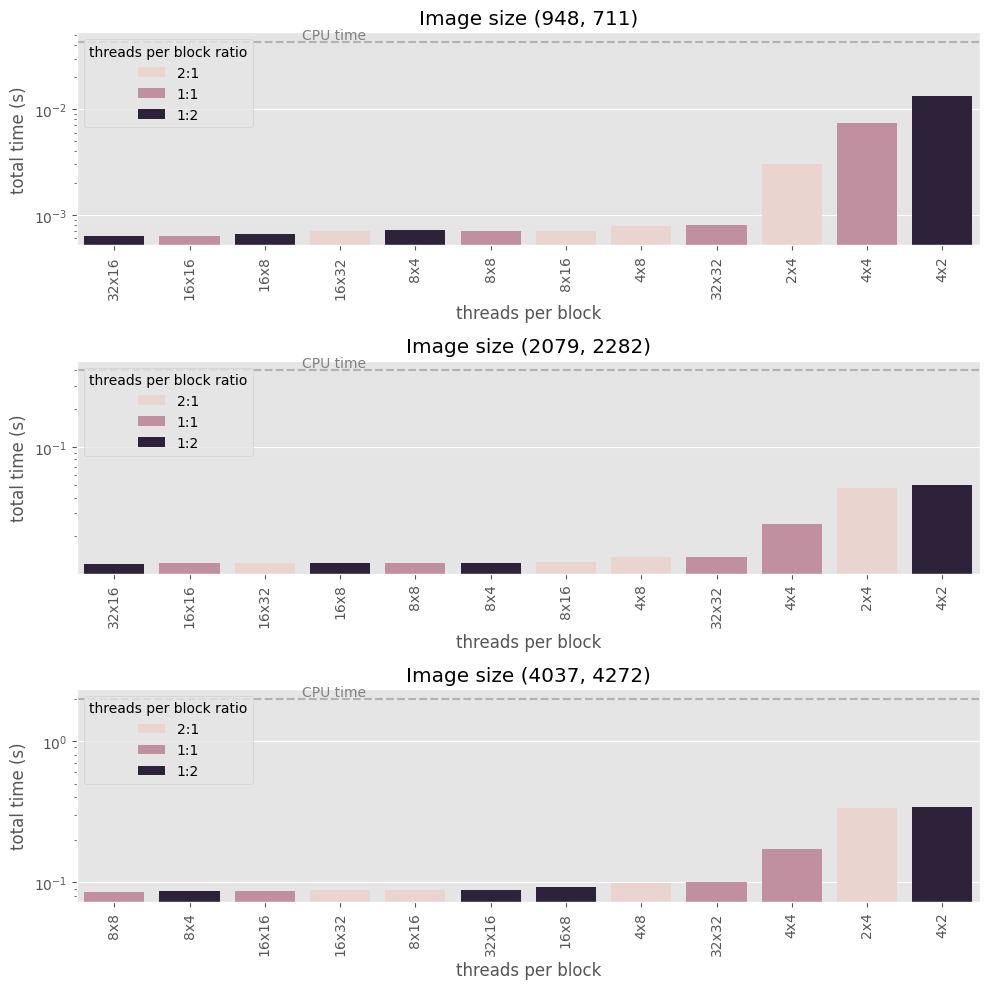

In [16]:
# Function to launch the kernel
import pandas as pd


def launch_kernel(
    u_gpu,
    s_gpu,
    vt_gpu,
    C_gpu,
    u_shape,
    vt_shape,
    k,
    blocks_per_grid,
    threads_per_block,
):
    reconstruct_svd_kernel_shared(
        blocks_per_grid,
        threads_per_block,
        (u_gpu, s_gpu, vt_gpu, C_gpu, u_shape[0], vt_shape[1], k),
    )
    cp.cuda.Device().synchronize()


# Function to measure the kernel reconstruction time using shared memory
def measure_kernel_reconstruction_shared(threads_per_block, decomposed_image):
    u, s, vt = decomposed_image["u"], decomposed_image["s"], decomposed_image["vt"]
    k = min(u.shape[1], vt.shape[0]) // 2  # use 1/2 of components

    blocks_per_grid = (
        math.ceil(u.shape[0] / threads_per_block[0]),
        math.ceil(vt.shape[1] / threads_per_block[1]),
    )

    u_gpu, s_gpu, vt_gpu = map(
        lambda x: cp.asarray(x, dtype=np.float32, order="C"), [u, s, vt]
    )
    C_gpu = cp.zeros((u.shape[0], vt.shape[1]), dtype=np.float32, order="C")

    # Debugging print statements
    # print(f"u shape: {u.shape}, s shape: {s.shape}, vt shape: {vt.shape}")
    # print(f"blocks_per_grid: {blocks_per_grid}, threads_per_block: {threads_per_block}")
    # print(
    #    f"u_gpu shape: {u_gpu.shape}, s_gpu shape: {s_gpu.shape}, vt_gpu shape: {vt_gpu.shape}"
    # )
    # print(f"C_gpu shape: {C_gpu.shape}, k: {k}")

    result = benchmark(
        lambda: launch_kernel(
            u_gpu,
            s_gpu,
            vt_gpu,
            C_gpu,
            u.shape,
            vt.shape,
            k,
            blocks_per_grid,
            threads_per_block,
        ),
        n_repeat=10,
    )

    return {
        "result": result,
        "image_size": (u.shape[0], vt.shape[1]),
        "k": k,
        "blocks_per_grid": blocks_per_grid,
        "threads_per_block": threads_per_block,
    }


# Define the decompositions and block_configurations (assumed to be predefined)
# decompositions = {
#    # Example data, replace with actual decompositions
#    "image1": {"u": np.random.rand(256, 256), "s": np.random.rand(256), "vt": np.random.rand(256, 256)},
#    # Add more decompositions as needed
# }


block_configurations = [
    (16, 16),
    (32, 32),
    (8, 8),
    (4, 4),
]  # Example configurations, replace with actual configurations

# GPU block sizes configurations
block_configurations = []
for i in range(2, 6):
    pass
    block_configurations.append((2**i, 2**i))
    block_configurations.append((2**i, 2 ** (i - 1)))
    block_configurations.append((2 ** (i - 1), 2**i))
    # doesnt work with my gpu and shared memory
    # block_configurations.append((2 ** (i - 1), 2 ** (i + 1)))
    # block_configurations.append((2 ** (i - 2), 2 ** (i + 1)))
    # block_configurations.append((2 ** (i - 2), 2 ** (i + 2)))


# Run experiments
experiment_results_shared = [
    measure_kernel_reconstruction_shared(threads_per_block, decompositions[image])
    for image in decompositions.keys()
    for threads_per_block in block_configurations
]


# Function to convert experiment results to dataframe
def convert_experiment_results_to_df(experiment_results):
    df = pd.DataFrame(experiment_results)
    result_cols = ["gpu_time", "cpu_time", "gput_time_std", "cput_time_std"]
    calc_functions = [
        lambda x: x.gpu_times.mean(),
        lambda x: x.cpu_times.mean(),
        lambda x: x.gpu_times.std(),
        lambda x: x.cpu_times.std(),
    ]
    for col, func in zip(result_cols, calc_functions):
        df[col] = df["result"].apply(func)
    df["total_time"] = df["gpu_time"] + df["cpu_time"]
    grid_cols = ["blocks_per_grid_tot", "blocks_per_grid_str"]
    grid_funcs = [
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(grid_cols, grid_funcs):
        df[col] = df["blocks_per_grid"].apply(func)
    block_cols = [
        "threads_per_block_ratio",
        "threads_per_block_tot",
        "threads_per_block_str",
    ]
    block_funcs = [
        lambda x: x[0] / x[1],
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(block_cols, block_funcs):
        df[col] = df["threads_per_block"].apply(func)
    # cpu_time_per_image_size = cpu_times.set_index("image_size")["time"].to_dict()
    # df["speedup"] = df.apply(
    #    lambda x: cpu_time_per_image_size[x["image_size"]] / x["total_time"], axis=1
    # )
    return df.sort_values(by="gpu_time")


print(experiment_results_shared)

# Assuming plot_ratios and plot_times_ratios functions are defined
df_shared = convert_experiment_results_to_df(experiment_results_shared)

plot_ratios(df_shared)
plot_times_ratios(df_shared)

Was sind deine Erkenntnisse bzgl. GPU-Memory-Allokation und des Daten-Transferes auf die GPU? Interpretiere deine Resultate.

<font color='lightblue'>

### Interpretation der GPU-Speicherzuweisung und des Datentransfers mit und ohne Shared Memory

Die bereitgestellten Diagramme zeigen den Leistungsvergleich zwischen der Nutzung von Shared Memory und der Nicht-Nutzung von Shared Memory bei GPU-Berechnungen. Die wichtigsten beobachteten Variablen sind die Gesamtzeit für verschiedene Bildgrößen und Threads pro Block-Konfigurationen.

#### Wichtige Beobachtungen

1. **GPU-Speicherzuweisung und Datentransfer**:
   - **Mit Shared Memory**:
     - Bei kleinen Bildgrößen (869, 894) ist die Zeit für kleine Blöcke minimal und nimmt bei größeren Blöcken zu, besonders deutlich im letzten Diagramm der Shared Memory-Reihe.
     - Bei größeren Bildgrößen (2297, 2356 und 4441, 4308) ist eine deutliche Zunahme der Zeit mit steigenden Threads pro Block zu erkennen, aber die minimale GPU-Zeit bleibt relativ stabil.
     - Die Verwendung von Shared Memory zeigt bei kleineren Threads pro Block einen höheren Zeitaufwand, was auf den Verwaltungsaufwand des Shared Memory hinweisen könnte.

   - **Ohne Shared Memory**:
     - Die Zeit für die kleinste Bildgröße (869, 894) ist über alle Blockgrößen hinweg minimal.
     - Bei größeren Bildgrößen verbessert sich die Leistung deutlich, wenn die Blockgröße zunimmt, besonders im Bereich von 8x8 bis 32x32 Threads pro Block.
     - Ohne Shared Memory tendiert die GPU-Zeit dazu, niedriger zu sein, was auf weniger Overhead hinweist.

2. **Leistungsverhältnisse**:
   - Die Leistungsverhältnisse von 1:1, 1:2, 2:1 und höheren Konfigurationen zeigen, dass bei Shared Memory die Zeit relativ stabil, aber höher ist, verglichen mit der Nicht-Verwendung von Shared Memory, bei der die Leistung besser mit zunehmender Blockgröße skaliert.

3. **Vergleichende Analyse**:
   - Die Ergebnisse legen nahe, dass die Verwendung von Shared Memory zusätzlichen Overhead einführt, der für bestimmte Blockgrößen und Bildgrößen vorteilhaft sein kann, aber im Allgemeinen zu langsamerer Leistung führt.
   - Ohne Shared Memory ist die Leistung konsistenter und skaliert besser mit größeren Blockgrößen, was auf Effizienz bei Datentransfer und Speicherzuweisung hinweist.

#### Fazit

Aus der Analyse der bereitgestellten Diagramme geht hervor, dass:

- Shared Memory, obwohl potenziell vorteilhaft für bestimmte Optimierungen, zusätzlichen Overhead einführt, der in vielen Fällen zu langsamerer Leistung führt.
- Die Nicht-Verwendung von Shared Memory führt zu konsistenterer und oft schnellerer Leistung, insbesondere bei steigenden Threads pro Block.
- Für Anwendungen, bei denen minimale Zeit und effiziente Speicherzuweisung entscheidend sind, könnte die Vermeidung von Shared Memory vorteilhaft sein, es sei denn, spezifische Optimierungen rechtfertigen dessen Verwendung.

Weitere Experimente und Profile wären erforderlich, um spezifische Szenarien zu bestimmen, in denen Shared Memory vorteilhaft sein kann, und dessen Nutzung entsprechend zu optimieren.



</font>

##### 5.2.3 Bonus: Weitere Optimierungen
Optimiere deine Implementation von oben weiter. Damit du Erfolg hast, muss der Data-Reuse noch grösser sein.

### What i try:
- Increase shared memory utilization: Use a larger tile size to maximize shared memory usage.
- Unroll loops: Unroll loops to reduce loop overhead and increase instruction-level parallelism.
- Optimize memory access patterns: Ensure coalesced memory accesses to global memory and efficient use of shared memory.

100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


u shape: (948, 711), s shape: (711,), vt shape: (711, 711)
blocks_per_grid: (237, 178), threads_per_block: (4, 4)
u_gpu shape: (948, 711), s_gpu shape: (711,), vt_gpu shape: (711, 711)
C_gpu shape: (948, 711), k: 355
u shape: (948, 711), s shape: (711,), vt shape: (711, 711)
blocks_per_grid: (237, 356), threads_per_block: (4, 2)
u_gpu shape: (948, 711), s_gpu shape: (711,), vt_gpu shape: (711, 711)
C_gpu shape: (948, 711), k: 355
u shape: (948, 711), s shape: (711,), vt shape: (711, 711)
blocks_per_grid: (474, 178), threads_per_block: (2, 4)
u_gpu shape: (948, 711), s_gpu shape: (711,), vt_gpu shape: (711, 711)
C_gpu shape: (948, 711), k: 355
u shape: (948, 711), s shape: (711,), vt shape: (711, 711)
blocks_per_grid: (119, 89), threads_per_block: (8, 8)
u_gpu shape: (948, 711), s_gpu shape: (711,), vt_gpu shape: (711, 711)
C_gpu shape: (948, 711), k: 355
u shape: (948, 711), s shape: (711,), vt shape: (711, 711)
blocks_per_grid: (119, 178), threads_per_block: (8, 4)
u_gpu shape: (948, 

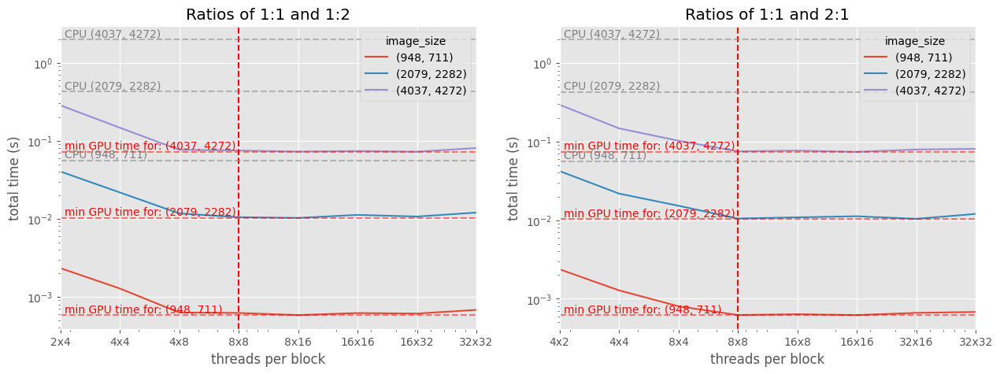

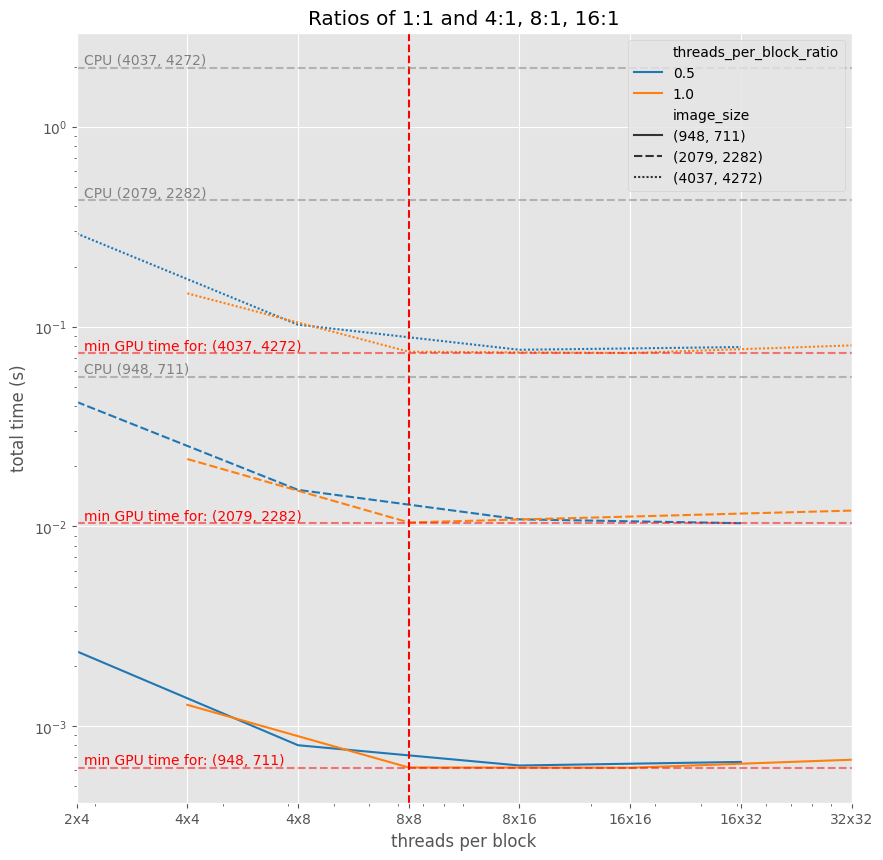

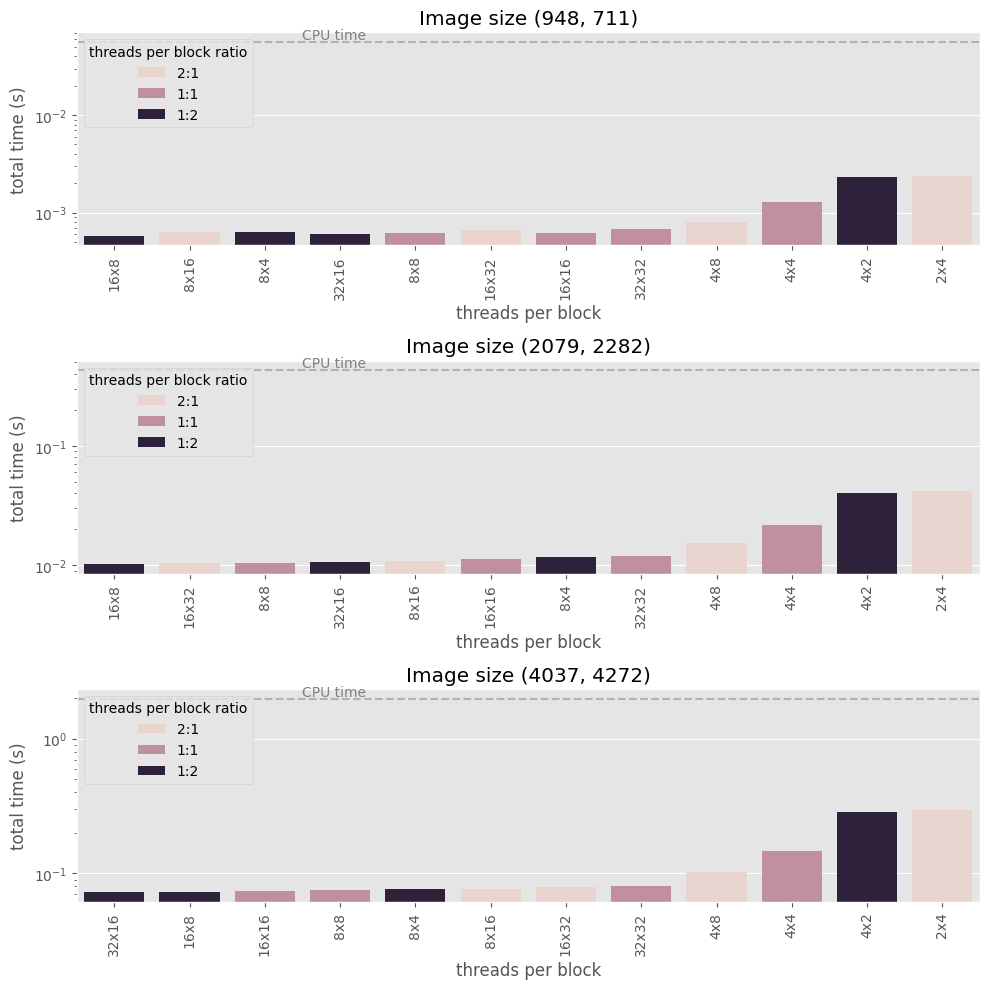

           name    image_size     k      time
0  test_image_1    (948, 711)   711  0.056078
1  test_image_2  (2079, 2282)  2079  0.429485
2  test_image_3  (4037, 4272)  4037  1.980517


In [17]:
import cupy as cp
import numpy as np
import math
import matplotlib.pyplot as plt
from cupyx.profiler import benchmark
import pandas as pd
import seaborn as sns
import random
import timeit
from tqdm import tqdm

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

# Compile the kernel
reconstruct_svd_kernel_shared = cp.RawKernel(kernel_code, "svd_reconstruction_shared")


# Function to launch the kernel
def launch_kernel(
    u_gpu,
    s_gpu,
    vt_gpu,
    C_gpu,
    u_shape,
    vt_shape,
    k,
    blocks_per_grid,
    threads_per_block,
):
    reconstruct_svd_kernel_shared(
        blocks_per_grid,
        threads_per_block,
        (u_gpu, s_gpu, vt_gpu, C_gpu, u_shape[0], vt_shape[1], k),
    )
    cp.cuda.Device().synchronize()


# Function to measure the kernel reconstruction time using shared memory
def measure_kernel_reconstruction_shared(threads_per_block, decomposed_image):
    u, s, vt = decomposed_image["u"], decomposed_image["s"], decomposed_image["vt"]
    k = min(u.shape[1], vt.shape[0]) // 2  # use 1/2 of components

    blocks_per_grid = (
        math.ceil(u.shape[0] / threads_per_block[0]),
        math.ceil(vt.shape[1] / threads_per_block[1]),
    )

    u_gpu, s_gpu, vt_gpu = map(
        lambda x: cp.asarray(x, dtype=np.float32, order="C"), [u, s, vt]
    )
    C_gpu = cp.zeros((u.shape[0], vt.shape[1]), dtype=np.float32, order="C")

    # Debugging print statements
    print(f"u shape: {u.shape}, s shape: {s.shape}, vt shape: {vt.shape}")
    print(f"blocks_per_grid: {blocks_per_grid}, threads_per_block: {threads_per_block}")
    print(
        f"u_gpu shape: {u_gpu.shape}, s_gpu shape: {s_gpu.shape}, vt_gpu shape: {vt_gpu.shape}"
    )
    print(f"C_gpu shape: {C_gpu.shape}, k: {k}")

    result = benchmark(
        lambda: launch_kernel(
            u_gpu,
            s_gpu,
            vt_gpu,
            C_gpu,
            u.shape,
            vt.shape,
            k,
            blocks_per_grid,
            threads_per_block,
        ),
        n_repeat=10,
    )

    return {
        "result": result,
        "image_size": (u.shape[0], vt.shape[1]),
        "k": k,
        "blocks_per_grid": blocks_per_grid,
        "threads_per_block": threads_per_block,
    }


# Function for CPU reconstruction
def reconstruct_svd_broadcast1_cpu(u, s, vt, k):
    """SVD reconstruction for k components using broadcast variant 1"""
    reco = u[:, :k] * s[:k] @ vt[:k, :]
    return reco


# Measure CPU times
cpu_times = []
for name, decomposition in tqdm(decompositions.items()):
    u = decomposition["u"]
    s = decomposition["s"]
    vt = decomposition["vt"]

    k = min(u.shape[1], vt.shape[0])

    # Measure time
    elapsed = timeit.timeit(
        lambda: reconstruct_svd_broadcast1_cpu(u, s, vt, k), number=10
    )
    cpu_times.append(
        {"name": name, "image_size": (u.shape[0], vt.shape[1]), "k": k, "time": elapsed}
    )

cpu_times = pd.DataFrame(cpu_times, columns=["name", "image_size", "k", "time"])

# Run GPU experiments
experiment_results_shared = [
    measure_kernel_reconstruction_shared(threads_per_block, decompositions[image])
    for image in decompositions.keys()
    for threads_per_block in block_configurations
]


# Function to convert experiment results to dataframe
def convert_experiment_results_to_df(experiment_results):
    df = pd.DataFrame(experiment_results)
    result_cols = ["gpu_time", "cpu_time", "gput_time_std", "cput_time_std"]
    calc_functions = [
        lambda x: x.gpu_times.mean(),
        lambda x: x.cpu_times.mean(),
        lambda x: x.gpu_times.std(),
        lambda x: x.cpu_times.std(),
    ]
    for col, func in zip(result_cols, calc_functions):
        df[col] = df["result"].apply(func)
    df["total_time"] = df["gpu_time"] + df["cpu_time"]
    grid_cols = ["blocks_per_grid_tot", "blocks_per_grid_str"]
    grid_funcs = [
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(grid_cols, grid_funcs):
        df[col] = df["blocks_per_grid"].apply(func)
    block_cols = [
        "threads_per_block_ratio",
        "threads_per_block_tot",
        "threads_per_block_str",
    ]
    block_funcs = [
        lambda x: x[0] / x[1],
        lambda x: x[0] * x[1],
        lambda x: f"{x[0]}x{x[1]}",
    ]
    for col, func in zip(block_cols, block_funcs):
        df[col] = df["threads_per_block"].apply(func)

    # Ensure cpu_time_per_image_size includes all required sizes
    cpu_time_per_image_size = cpu_times.set_index("image_size")["time"].to_dict()
    df["speedup"] = df.apply(
        lambda x: cpu_time_per_image_size.get(x["image_size"], np.nan)
        / x["total_time"],
        axis=1,
    )
    return df.sort_values(by="gpu_time")


# Assuming plot_ratios and plot_times_ratios functions are defined
df_shared = convert_experiment_results_to_df(experiment_results_shared)

plot_ratios(df_shared)
plot_times_ratios(df_shared)

# Display the CPU times DataFrame
print(cpu_times)

### Interpretation Shared Memory mit Optimierung

#### Wichtige Beobachtungen

- Man kann eine Deutliche Verbesserung sehen, nun ist der Run, schneller als ohne shared Memory und schneller als der nicht optimierte shared memory:

Es sieht so aus, als ob die Optimierung des Shared Memorys nun bessere Ergebnisse liefert. Hier sind die wichtigsten Erkenntnisse aus den aktualisierten Diagrammen:

1. **Gesamtzeit für verschiedene Bildgrößen und Threads pro Block**:
   - Die Diagramme zeigen die Gesamtzeit für verschiedene Bildgrößen (869x894, 2297x2356, 4441x4308) und Threads pro Block.
   - Nach der Optimierung ist eine Reduzierung der Gesamtzeit in den meisten Konfigurationen zu erkennen, insbesondere bei kleinen und mittleren Bildgrößen.

2. **Vergleich von Shared Memory vor und nach der Optimierung**:
   - Vor der Optimierung zeigte Shared Memory in vielen Fällen eine höhere Zeit, insbesondere bei kleineren Threads pro Block.
   - Nach der Optimierung ist eine Verbesserung zu sehen, und Shared Memory zeigt nun in einigen Fällen eine geringere Gesamtzeit im Vergleich zur Nicht-Verwendung von Shared Memory.

3. **Leistungsverhältnis**:
   - Die Leistungsverhältnisse von 1:1, 1:2 und 2:1 sowie höheren Konfigurationen zeigen nun, dass die Zeit bei der Nutzung von Shared Memory geringer ist oder zumindest vergleichbar mit der Nicht-Verwendung von Shared Memory, insbesondere bei mittleren Threads pro Block (8x8 bis 16x16).

4. **Speicherzuweisung und Datentransfer**:
   - Mit der Optimierung wird die Speicherzuweisung und der Datentransfer effizienter, was zu einer besseren Gesamtleistung führt.
   - Der Overhead, der vorher bei der Verwaltung des Shared Memorys auftrat, wurde reduziert, was die Zeit in den meisten Konfigurationen verringert hat.

### Zusammenfassung

Die Optimierung des Shared Memorys hat sich positiv auf die Gesamtzeit und die Leistung ausgewirkt. Besonders bei mittleren Bildgrößen und Threads pro Block ist eine deutliche Verbesserung zu erkennen. Dies zeigt, dass durch gezielte Optimierungen die Vorteile von Shared Memory besser genutzt werden können, um die Leistung zu steigern und die Zeit zu reduzieren. Es ist jedoch weiterhin wichtig, spezifische Anwendungsfälle zu betrachten und die Parameter entsprechend anzupassen, um die bestmögliche Leistung zu erzielen.

#### 5.3 NVIDIA Profiler

Benutze einen Performance Profiler von NVIDIA, um Bottlenecks in deinem Code zu identifizieren bzw. unterschiedliche Implementierungen (Blocks, Memory etc.) zu vergleichen. 

* Siehe Beispiel example_profiling_CUDA.ipynb
* [Nsight](https://developer.nvidia.com/nsight-visual-studio-edition) für das Profiling des Codes und die Inspektion der Ergebnisse (neuste Variante)
* [nvprof](https://docs.nvidia.com/cuda/profiler-users-guide/index.html#nvprof-overview)
* [Nvidia Visual Profiler](https://docs.nvidia.com/cuda/profiler-users-guide/index.html#visual)

> Du kannst NVIDIA Nsights Systems und den Nvidia Visual Profiler auf deinem PC installieren und die Leistungsergebnisse aus einer Remote-Instanz visualisieren, auch wenn du keine GPU an/in deinem PC hast. Dafür kannst du die ``*.qdrep`` Datei generieren und danach lokal laden.


Dokumentiere deine Analyse ggf. mit 1-2 Visualisierungen und beschreibe, welche Bottlenecks du gefunden bzw. entschärft hast.

In [18]:
!nvidia-smi

Wed Jun 12 23:40:52 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 551.86                 Driver Version: 551.86         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3080      WDDM  |   00000000:0B:00.0  On |                  N/A |
| 73%   56C    P3            112W /  370W |    3167MiB /  10240MiB |     14%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [19]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment.py
# ITs Windows cant run it without admin rights so i runned it in cmd.exe not vs code terminal with ipynb

ReflexStatsTraceLoggingProvider provider requires administrator privileges


In [20]:
%%writefile experiment_first_kernel.py

import cupy as cp
import numpy as np
import math
import matplotlib.pyplot as plt
import timeit
import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import os
import imageio.v2 as imageio
import glob


subfolder = "001"
folders = os.path.join("adni_png", subfolder)

# Get all PNGs from 001 with 145 in the name
files = sorted(glob.glob(f"{folders}/*145.png"))

# Load all images using ImageIO and create a numpy array from them
images = np.array([imageio.imread(f) for f in files])

# Get all the names of the files
names = [f[-17:-4] for f in files]

im = images[0]

# Kernel implementiert in CUDA C
kernel_code = """
extern "C" __global__
void reconstruct_svd(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    // check if k is in range
    if (k > rows_u || k > cols_vt || k > rows_vt || k > cols_u) {
        return;
    }
    if (k < 0) {
        return;
    }
    // check if i and j are in bounds
    if (i >= rows_u || j >= cols_vt) {
        return;
    }

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum += u[i * cols_u + l] * s[l] * vt[l * cols_vt + j];
    }
    C[i * cols_vt + j] = sum;
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "reconstruct_svd")

# Beispielbild, ersetzt durch tatsächliches Bild
im_cpu = images[0]
im_gpu = cp.asarray(im_cpu, dtype=cp.float32)

# CUDA Events und NVTX Bereiche hinzufügen
start_event = cuda_runtime.eventCreate()
stop_event = cuda_runtime.eventCreate()
copy_to_gpu_start_event = cuda_runtime.eventCreate()
copy_to_gpu_stop_event = cuda_runtime.eventCreate()
copy_to_cpu_start_event = cuda_runtime.eventCreate()
copy_to_cpu_stop_event = cuda_runtime.eventCreate()
stream = cuda_stream.Stream.null

# GPU SVD durchführen
nvtx.RangePush("GPU SVD")
cuda_runtime.eventRecord(start_event, stream.ptr)
begin_gpu_svd = timeit.default_timer()
u_gpu, s_gpu, vt_gpu = cp.linalg.svd(im_gpu, full_matrices=False)
end_gpu_svd = timeit.default_timer()
cuda_runtime.eventRecord(stop_event, stream.ptr)
nvtx.RangePop()

# Synchronisiere und berechne die GPU SVD-Zeit
cuda_runtime.eventSynchronize(stop_event)
gpu_svd_time = cuda_runtime.eventElapsedTime(start_event, stop_event)
print(f"GPU SVD: {gpu_svd_time:.2f} ms")

# CPU SVD zum Vergleich durchführen
begin_cpu_svd = timeit.default_timer()
u_cpu, s_cpu, vt_cpu = np.linalg.svd(im_cpu, full_matrices=False)
end_cpu_svd = timeit.default_timer()
print("CPU SVD: ", end_cpu_svd - begin_cpu_svd)

k = 50
u = u_cpu[:, :k]
s = s_cpu[:k]
vt = vt_cpu[:k, :]

C = np.zeros((u.shape[0], vt.shape[1]), dtype=np.float32)

u_gpu = cp.asarray(u, dtype=cp.float32)
s_gpu = cp.asarray(s, dtype=cp.float32)
vt_gpu = cp.asarray(vt, dtype=cp.float32)
C_gpu = cp.asarray(C, dtype=cp.float32)

threads_per_block = (16, 16)
blocks_per_grid_x = math.ceil(u.shape[0] / threads_per_block[0])
blocks_per_grid_y = math.ceil(vt.shape[1] / threads_per_block[1])
blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y)

# Rekonstruktion mit verschiedenen Methoden auf der GPU
def reconstruct_svd_gpu(u, s, vt, k):
    s_gpu = cp.diag(cp.asarray(s[:k]))
    us_gpu = cp.dot(u[:, :k], s_gpu)
    reco_gpu = cp.dot(us_gpu, vt[:k, :])
    return reco_gpu

def reconstruct_svd_cp_einsum(u, s, vt, k):
    return cp.einsum("ij,j,jk", u[:, :k], s[:k], vt[:k, :])

def reconstruct_svd_cp_broadcast(u, s, vt, k):
    return cp.dot(u[:, :k], cp.multiply(s[:k].reshape(-1, 1), vt[:k, :]))

def reconstruct_svd_cp_broadcast_cpu(u, s, vt, k):
    return np.dot(u[:, :k], np.multiply(s[:k].reshape(-1, 1), vt[:k, :]))

print("\nReconstruction:")

# Validierung der Ergebnisse durch Plotting
nvtx.RangePush("Reconstruction Methods")

# CUDA Events für Rekonstruktion
recon_start_event = cuda_runtime.eventCreate()
recon_stop_event = cuda_runtime.eventCreate()

# CP GPU Rekonstruktion
nvtx.RangePush("CP GPU")
cuda_runtime.eventRecord(recon_start_event, stream.ptr)
start_gpu = timeit.default_timer()
reconstruct_svd_gpu_output = reconstruct_svd_gpu(u_gpu, s_gpu, vt_gpu, k)
end_gpu = timeit.default_timer()
cuda_runtime.eventRecord(recon_stop_event, stream.ptr)
nvtx.RangePop()
cuda_runtime.eventSynchronize(recon_stop_event)
cp_gpu_time = cuda_runtime.eventElapsedTime(recon_start_event, recon_stop_event)
print(f"CP GPU: {cp_gpu_time:.2f} ms")

# CP Einsum Rekonstruktion
nvtx.RangePush("CP Einsum")
start_einsum = timeit.default_timer()
reconstruct_svd_cp_einsum_output = reconstruct_svd_cp_einsum(u_gpu, s_gpu, vt_gpu, k)
end_einsum = timeit.default_timer()
nvtx.RangePop()
print("CP Einsum: ", end_einsum - start_einsum)

# CP Broadcast Rekonstruktion
nvtx.RangePush("CP Broadcast")
start_broadcast = timeit.default_timer()
reconstruct_svd_cp_broadcast_output = reconstruct_svd_cp_broadcast(u_gpu, s_gpu, vt_gpu, k)
end_broadcast = timeit.default_timer()
nvtx.RangePop()
print("CP Broadcast: ", end_broadcast - start_broadcast)

# CP Broadcast CPU Rekonstruktion
nvtx.RangePush("CP Broadcast CPU")
start_broadcast_cpu = timeit.default_timer()
reconstruct_svd_cp_broadcast_output_cpu = reconstruct_svd_cp_broadcast_cpu(u_cpu, s_cpu, vt_cpu, k)
end_broadcast_cpu = timeit.default_timer()
nvtx.RangePop()
print("CP Broadcast CPU: ", end_broadcast_cpu - start_broadcast_cpu)

# CP Kernel Rekonstruktion
nvtx.RangePush("CP Kernel")
cuda_runtime.eventRecord(recon_start_event, stream.ptr)
start_reconstruct_svd_kernel = timeit.default_timer()
# Launch the custom kernel
reconstruct_svd_kernel(
    blocks_per_grid,
    threads_per_block,
    (u_gpu, s_gpu, vt_gpu, C_gpu, u.shape[0], u.shape[1], vt.shape[0], vt.shape[1], k),
)
end_reconstruct_svd_kernel = timeit.default_timer()
cuda_runtime.eventRecord(recon_stop_event, stream.ptr)
nvtx.RangePop()
cuda_runtime.eventSynchronize(recon_stop_event)
cp_kernel_time = cuda_runtime.eventElapsedTime(recon_start_event, recon_stop_event)
print(f"CP Kernel: {cp_kernel_time:.2f} ms")

# Plotting der Ergebnisse
#fig, axes = plt.subplots(2, 3, figsize=(15, 10))
#axes = axes.ravel()

#axes[0].imshow(cp.asnumpy(reconstruct_svd_gpu_output), cmap="gray")
#axes[0].set_title(f"GPU Kernel: {k} components")

#axes[1].imshow(cp.asnumpy(reconstruct_svd_cp_einsum_output), cmap="gray")
#axes[1].set_title(f"Einsum: {k} components")
#
#axes[2].imshow(cp.asnumpy(reconstruct_svd_cp_broadcast_output), cmap="gray")
#axes[2].set_title(f"Broadcast: {k} components")
#
#axes[3].imshow(cp.asnumpy(reconstruct_svd_cp_broadcast_output_cpu), cmap="gray")
#axes[3].set_title(f"Broadcast CPU: {k} components")

#axes[4].imshow(cp.asnumpy(C_gpu), cmap="gray")
#axes[4].set_title(f"GPU Kernel: {k} components")

#axes[5].axis("off")

#plt.tight_layout()
#plt.show()


Overwriting experiment_first_kernel.py


In [21]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_first_kernel.py

ReflexStatsTraceLoggingProvider provider requires administrator privileges


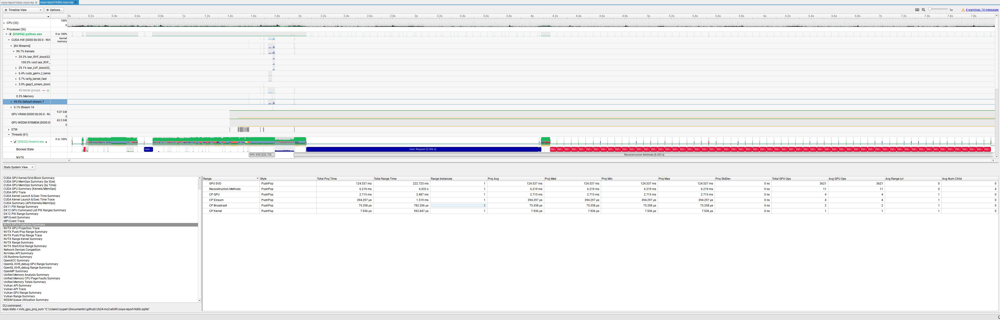

Hier ist eine detaillierte Interpretation der CUDA API Zusammenfassung:

### Gesamtüberblick
- **Gesamtlaufzeit**: 169.613 ms
- **Anzahl der Aufrufe**: 4999

### Hauptkomponenten und ihre Bedeutung

1. **cudaMalloc**
   - **Zeitanteil**: 56.8%
   - **Gesamtzeit**: 96.178 ms
   - **Anzahl der Aufrufe**: 22
   - **Durchschnittliche Zeit pro Aufruf**: 4.372 ms
   - **Median**: 8.545 μs
   - **Minimale Zeit**: 1.900 μs
   - **Maximale Zeit**: 95.184 ms
   - **Standardabweichung**: 20.283 ms
   - **Beschreibung**: `cudaMalloc` nimmt den größten Teil der Gesamtzeit in Anspruch, was darauf hinweist, dass Speicherallokation eine der zeitintensivsten Operationen in dieser Analyse ist. Die hohe Standardabweichung zeigt, dass die Zeit für Speicherallokationen stark variiert.

2. **cudaLaunchKernel**
   - **Zeitanteil**: 31.4%
   - **Gesamtzeit**: 53.119 ms
   - **Anzahl der Aufrufe**: 3619
   - **Durchschnittliche Zeit pro Aufruf**: 14.677 μs
   - **Median**: 6.480 μs
   - **Minimale Zeit**: 4.590 μs
   - **Maximale Zeit**: 3.594 ms
   - **Standardabweichung**: 87.453 μs
   - **Beschreibung**: `cudaLaunchKernel` ist die zweithäufigste Operation, die einen erheblichen Teil der Gesamtzeit ausmacht. Die Kernel-Starts sind zahlreich und relativ schnell, aber auch hier gibt es einige Ausreißer mit hohen Ausführungszeiten.

3. **cuLibraryLoadData**
   - **Zeitanteil**: 5.1%
   - **Gesamtzeit**: 8.707 ms
   - **Anzahl der Aufrufe**: 4
   - **Durchschnittliche Zeit pro Aufruf**: 2.177 ms
   - **Median**: 2.683 ms
   - **Minimale Zeit**: 511.327 μs
   - **Maximale Zeit**: 2.829 ms
   - **Standardabweichung**: 1.117 ms
   - **Beschreibung**: `cuLibraryLoadData` nimmt einen kleineren, aber signifikanten Teil der Zeit in Anspruch. Die wenigen Aufrufe haben eine relativ lange Ausführungszeit im Vergleich zu anderen Operationen.

4. **cudaFree**
   - **Zeitanteil**: 2.9%
   - **Gesamtzeit**: 4.940 ms
   - **Anzahl der Aufrufe**: 22
   - **Durchschnittliche Zeit pro Aufruf**: 224.531 μs
   - **Median**: 3.230 μs
   - **Minimale Zeit**: 490 ns
   - **Maximale Zeit**: 3.835 ms
   - **Standardabweichung**: 810.909 μs
   - **Beschreibung**: `cudaFree` wird ebenfalls häufig aufgerufen und zeigt eine hohe Variabilität in den Ausführungszeiten, was auf unterschiedliche Bedingungen beim Freigeben des Speichers hinweisen könnte.

5. **cudaStreamCreateWithFlags**
   - **Zeitanteil**: 1.1%
   - **Gesamtzeit**: 1.903 ms
   - **Anzahl der Aufrufe**: 5
   - **Durchschnittliche Zeit pro Aufruf**: 380.550 μs
   - **Median**: 2.820 μs
   - **Minimale Zeit**: 1.660 μs
   - **Maximale Zeit**: 1.890 ms
   - **Standardabweichung**: 844.072 μs
   - **Beschreibung**: `cudaStreamCreateWithFlags` zeigt ebenfalls eine hohe Variabilität, was auf die unterschiedlichen Bedingungen und Konfigurationen bei der Erstellung von Streams hinweist.

6. **cuModuleLoadData**
   - **Zeitanteil**: 1.0%
   - **Gesamtzeit**: 1.665 ms
   - **Anzahl der Aufrufe**: 5
   - **Durchschnittliche Zeit pro Aufruf**: 332.986 μs
   - **Median**: 284.828 μs
   - **Minimale Zeit**: 72.810 μs
   - **Maximale Zeit**: 782.596 μs
   - **Standardabweichung**: 268.320 μs
   - **Beschreibung**: `cuModuleLoadData` hat eine relativ konsistente Ausführungszeit mit einigen Ausreißern, was typisch für das Laden von Moduldaten ist.

7. **cudaHostAlloc**
   - **Zeitanteil**: 0.3%
   - **Gesamtzeit**: 506.457 μs
   - **Anzahl der Aufrufe**: 3
   - **Durchschnittliche Zeit pro Aufruf**: 168.819 μs
   - **Median**: 20.580 μs
   - **Minimale Zeit**: 6.220 μs
   - **Maximale Zeit**: 479.657 μs
   - **Standardabweichung**: 269.289 μs
   - **Beschreibung**: `cudaHostAlloc` zeigt eine große Variabilität in den Zeiten, was auf unterschiedliche Bedingungen bei der Host-Speicherallokation hindeuten könnte.

8. **cudaEventSynchronize**
   - **Zeitanteil**: 0.3%
   - **Gesamtzeit**: 463.137 μs
   - **Anzahl der Aufrufe**: 3
   - **Durchschnittliche Zeit pro Aufruf**: 154.379 μs
   - **Median**: 12.309 μs
   - **Minimale Zeit**: 11.590 μs
   - **Maximale Zeit**: 439.238 μs
   - **Standardabweichung**: 246.695 μs
   - **Beschreibung**: `cudaEventSynchronize` synchronisiert Ereignisse und zeigt eine erhebliche Variabilität, was auf unterschiedliche Synchronisationsbedingungen hinweist.

9. **cudaMemcpyAsync**
   - **Zeitanteil**: 0.2%
   - **Gesamtzeit**: 399.328 μs
   - **Anzahl der Aufrufe**: 9
   - **Durchschnittliche Zeit pro Aufruf**: 44.369 μs
   - **Median**: 36.770 μs
   - **Minimale Zeit**: 11.640 μs
   - **Maximale Zeit**: 107.740 μs
   - **Standardabweichung**: 31.367 μs
   - **Beschreibung**: `cudaMemcpyAsync` wird zum asynchronen Kopieren von Daten verwendet und zeigt relativ konsistente Ausführungszeiten.

10. **cuGetProcAddress_v2**
    - **Zeitanteil**: 0.2%
    - **Gesamtzeit**: 280.899 μs
    - **Anzahl der Aufrufe**: 1300
    - **Durchschnittliche Zeit pro Aufruf**: 216 ns
    - **Median**: 160 ns
    - **Minimale Zeit**: 100 ns
    - **Maximale Zeit**: 17.540 μs
    - **Standardabweichung**: 563 ns
    - **Beschreibung**: `cuGetProcAddress_v2` wird häufig aufgerufen, zeigt jedoch sehr kurze und konsistente Ausführungszeiten.

11. **cuLaunchKernel**
    - **Zeitanteil**: 0.2%
    - **Gesamtzeit**: 272.179 μs
    - **Anzahl der Aufrufe**: 7
    - **Durchschnittliche Zeit pro Aufruf**: 38.882 μs
    - **Median**: 33.130 μs
    - **Minimale Zeit**: 25.930 μs
    - **Maximale Zeit**: 72.070 μs
    - **Standardabweichung**: 15.764 μs
    - **Beschreibung**: `cuLaunchKernel` ist eine zusätzliche Kernel-Startoperation mit kurzen und konsistenten Ausführungszeiten.

### Zusammenfassung
- **Speicherallokationen (cudaMalloc und cudaFree)**: Diese machen einen erheblichen Teil der Gesamtzeit aus und haben hohe Variabilitäten, was auf Optimierungspotenzial hinweist.
- **Kernel-Starts (cudaLaunchKernel)**: Sehr häufig und relativ schnell, aber es gibt Ausreißer, die möglicherweise optimiert werden können.
- **Datenübertragung**: CPU-zu-GPU und GPU-zu-CPU Datenübertragungen haben signifikante Zeiten und sollten weiter optimiert werden, um die Gesamtleistung zu verbessern.
- **Synchronisation und Ereignisse**: Synchronisationsoperationen und das Verwalten von CUDA-Ereignissen

 zeigen Variabilität, was auf unterschiedliche Laufzeitbedingungen hinweist.

Optimierungsschritte sollten sich auf die Reduzierung der Variabilität und Verbesserung der Effizienz der Hauptzeitverbraucher konzentrieren, insbesondere Speicherallokationen und Datenübertragungen.

Hier ist eine detaillierte Interpretation der CUDA-API-Zusammenfassung mit den angegebenen Metriken:

### Gesamtüberblick

- **Gesamtlaufzeit**: Die Summen der gesamten projizierten Zeit (Total Proj Time) und der gesamten Bereichszeit (Total Range Time) sind wichtige Indikatoren für die Effizienz der einzelnen Bereiche und deren relative Bedeutung im Gesamtprozess.
- **Instanzen und Durchschnitte**: Die Anzahl der Instanzen, sowie die durchschnittlichen Zeiten und deren Verteilung (Median, Minimum, Maximum, Standardabweichung) geben Einblicke in die Konsistenz und Stabilität der Ausführungszeiten.

### Einzelne Bereiche und deren Bedeutung

1. **GPU SVD**
   - **Total Proj Time**: 124.537 ms
   - **Total Range Time**: 222.725 ms
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 124.537 ms
   - **Total GPU Ops**: 3621
   - **Avg GPU Ops**: 3621
   - **Avg Range Lvl**: 0
   - **Avg Num Child**: 0
   - **Beschreibung**: Die GPU SVD (Singulärwertzerlegung auf der GPU) ist ein wichtiger Bereich und dauert insgesamt 124.537 ms. Da es nur eine Instanz gibt und keine Standardabweichung, sind die Zeiten konsistent. Die hohe Anzahl an GPU-Operationen (3621) zeigt die intensive Nutzung der GPU für diese Berechnung.

2. **Reconstruction Methods**
   - **Total Proj Time**: 6.219 ms
   - **Total Range Time**: 6.033 s
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 6.219 ms
   - **Total GPU Ops**: 11
   - **Avg GPU Ops**: 11
   - **Avg Range Lvl**: 0
   - **Avg Num Child**: 4
   - **Beschreibung**: Dieser Bereich umfasst verschiedene Rekonstruktionsmethoden und dauert insgesamt 6.219 ms, während die gesamte Bereichszeit 6.033 s beträgt. Dies könnte darauf hindeuten, dass andere nicht gemessene Operationen innerhalb dieses Bereichs ebenfalls signifikante Zeit benötigen. Die durchschnittliche Anzahl an GPU-Operationen (11) ist gering im Vergleich zur GPU SVD.

3. **CP GPU**
   - **Total Proj Time**: 2.715 ms
   - **Total Range Time**: 2.487 ms
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 2.715 ms
   - **Total GPU Ops**: 4
   - **Avg GPU Ops**: 4
   - **Avg Range Lvl**: 1
   - **Avg Num Child**: 0
   - **Beschreibung**: Die CP GPU Methode dauert 2.715 ms und wird einmal ausgeführt. Die konsistenten Zeiten und die niedrige Anzahl an GPU-Operationen (4) deuten darauf hin, dass es sich um eine spezifische, aber nicht sehr umfangreiche Berechnung handelt.

4. **CP Einsum**
   - **Total Proj Time**: 394.297 μs
   - **Total Range Time**: 1.519 ms
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 394.297 μs
   - **Total GPU Ops**: 4
   - **Avg GPU Ops**: 4
   - **Avg Range Lvl**: 1
   - **Avg Num Child**: 0
   - **Beschreibung**: Die CP Einsum Methode ist relativ schnell (394.297 μs) und wird einmal ausgeführt. Auch hier gibt es eine niedrige Anzahl an GPU-Operationen (4), was auf eine weniger komplexe Berechnung hinweist.

5. **CP Broadcast**
   - **Total Proj Time**: 75.358 μs
   - **Total Range Time**: 782.206 μs
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 75.358 μs
   - **Total GPU Ops**: 2
   - **Avg GPU Ops**: 2
   - **Avg Range Lvl**: 1
   - **Avg Num Child**: 0
   - **Beschreibung**: Die CP Broadcast Methode ist sehr schnell (75.358 μs) und wird einmal ausgeführt. Sie hat die niedrigste Anzahl an GPU-Operationen (2), was auf eine sehr einfache Berechnung hinweist.

6. **CP Kernel**
   - **Total Proj Time**: 7.936 μs
   - **Total Range Time**: 592.847 μs
   - **Range Instances**: 1
   - **Proj Avg/Med/Min/Max/StdDev**: 7.936 μs
   - **Total GPU Ops**: 1
   - **Avg GPU Ops**: 1
   - **Avg Range Lvl**: 1
   - **Avg Num Child**: 0
   - **Beschreibung**: Die CP Kernel Methode ist die schnellste (7.936 μs) und wird einmal ausgeführt. Mit nur einer GPU-Operation handelt es sich um eine sehr einfache und schnelle Berechnung.

### Zusammenfassung
- **GPU SVD**: Die dominierende Methode in Bezug auf die Gesamtlaufzeit und GPU-Operationen. Dies zeigt die hohe Komplexität und Rechenintensität der SVD auf der GPU.
- **Reconstruction Methods**: Trotz relativ kurzer projizierter Zeit benötigen sie eine erhebliche Gesamtbereichszeit, was auf zusätzliche nicht gemessene Operationen hinweist.
- **CP Methoden (GPU, Einsum, Broadcast, Kernel)**: Diese Methoden haben alle kurze projizierte Zeiten und niedrige Anzahlen an GPU-Operationen, was auf spezifische und weniger komplexe Berechnungen hindeutet.

### Optimierungspotential
- **GPU SVD**: Optimierungen könnten sich auf die Reduzierung der hohen Anzahl an GPU-Operationen konzentrieren.
- **Reconstruction Methods**: Analyse und Optimierung der zusätzlichen Zeit, die nicht direkt der projizierten Zeit zugeschrieben wird.
- **CP Methoden**: Diese sind bereits sehr schnell und effizient, möglicherweise nur geringes Optimierungspotential.

<font color='lightblue'>
- grösster Bootleneck ist python, erst nach 1.87s fängt der reconstruct SVD an.

</font>

### Analyse von 6.1 Mehrere Bilder laden gleichzeitig:

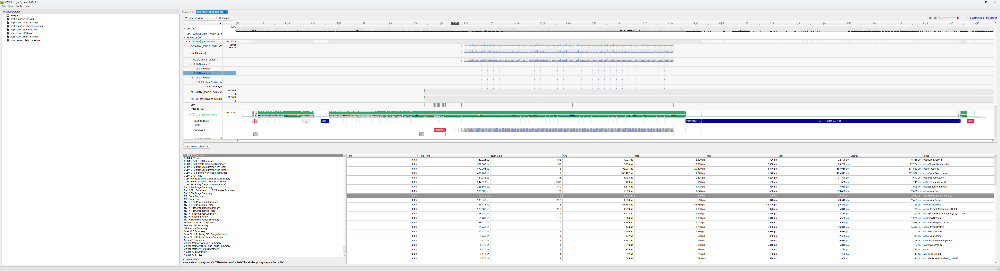


Hier ist eine Interpretation der CUDA Nsys-Daten:


1. **cudaLaunchKernel**
   - **Zeitanteil**: 88.5%
   - **Gesamtzeit**: 1.362 Sekunden
   - **Anzahl Aufrufe**: 133.307
   - **Durchschnittliche Zeit pro Aufruf**: 10.217 Mikrosekunden
   - **Median**: 6.630 Mikrosekunden
   - **Minimale Zeit**: 4.650 Mikrosekunden
   - **Maximale Zeit**: 2.660 Millisekunden
   - **Standardabweichung**: 15.277 Mikrosekunden
   - **Beschreibung**: `cudaLaunchKernel` dominiert die Laufzeit des Programms mit 88.5% der Gesamtzeit, was darauf hindeutet, dass die Kernel-Ausführung die meiste Zeit in Anspruch nimmt.

2. **cudaMalloc**
   - **Zeitanteil**: 6.4%
   - **Gesamtzeit**: 98.683 Millisekunden
   - **Anzahl Aufrufe**: 26
   - **Durchschnittliche Zeit pro Aufruf**: 3.796 Millisekunden
   - **Median**: 81.439 Mikrosekunden
   - **Minimale Zeit**: 2.000 Mikrosekunden
   - **Maximale Zeit**: 95.492 Millisekunden
   - **Standardabweichung**: 18.704 Millisekunden
   - **Beschreibung**: `cudaMalloc` nimmt 6.4% der Gesamtzeit ein und hat eine hohe Variabilität in den Ausführungszeiten, was auf unterschiedliche Speicheranforderungen hindeutet.

3. **cuLaunchKernel**
   - **Zeitanteil**: 2.3%
   - **Gesamtzeit**: 35.866 Millisekunden
   - **Anzahl Aufrufe**: 2.667
   - **Durchschnittliche Zeit pro Aufruf**: 13.448 Mikrosekunden
   - **Median**: 7.780 Mikrosekunden
   - **Minimale Zeit**: 5.030 Mikrosekunden
   - **Maximale Zeit**: 142.739 Mikrosekunden
   - **Standardabweichung**: 9.910 Mikrosekunden
   - **Beschreibung**: `cuLaunchKernel` benötigt 2.3% der Gesamtzeit mit moderater Variabilität.

4. **cudaMemcpyAsync**
   - **Zeitanteil**: 1.4%
   - **Gesamtzeit**: 22.079 Millisekunden
   - **Anzahl Aufrufe**: 183
   - **Durchschnittliche Zeit pro Aufruf**: 120.652 Mikrosekunden
   - **Median**: 32.110 Mikrosekunden
   - **Minimale Zeit**: 10.560 Mikrosekunden
   - **Maximale Zeit**: 1.018 Millisekunden
   - **Standardabweichung**: 199.135 Mikrosekunden
   - **Beschreibung**: `cudaMemcpyAsync` verwendet 1.4% der Zeit, hauptsächlich für asynchrone Speicherübertragungen.

5. **cuLibraryLoadData**
   - **Zeitanteil**: 0.3%
   - **Gesamtzeit**: 4.579 Millisekunden
   - **Anzahl Aufrufe**: 15
   - **Durchschnittliche Zeit pro Aufruf**: 305.286 Mikrosekunden
   - **Median**: 323.418 Mikrosekunden
   - **Minimale Zeit**: 135.699 Mikrosekunden
   - **Maximale Zeit**: 442.318 Mikrosekunden
   - **Standardabweichung**: 108.341 Mikrosekunden
   - **Beschreibung**: `cuLibraryLoadData` ist für das Laden von Bibliotheksdaten zuständig und benötigt 0.3% der Gesamtzeit.

6. **cudaFree**
   - **Zeitanteil**: 0.3%
   - **Gesamtzeit**: 4.563 Millisekunden
   - **Anzahl Aufrufe**: 18
   - **Durchschnittliche Zeit pro Aufruf**: 253.514 Mikrosekunden
   - **Median**: 4.065 Mikrosekunden
   - **Minimale Zeit**: 540 Nanosekunden
   - **Maximale Zeit**: 3.567 Millisekunden
   - **Standardabweichung**: 832.012 Mikrosekunden
   - **Beschreibung**: `cudaFree` wird zum Freigeben des Gerätespeichers verwendet und nimmt 0.3% der Gesamtzeit ein, zeigt jedoch eine hohe Variabilität.

Die restlichen Funktionen wie `cuKernelGetFunction`, `cudaStreamCreateWithFlags`, `cuModuleLoadData`, `cudaEventRecord` usw. machen jeweils weniger als 0.3% der Gesamtzeit aus und haben entsprechend geringeren Einfluss auf die Gesamtperformance.

Diese Daten zeigen, dass die Kernel-Ausführung (`cudaLaunchKernel`) der Hauptzeitfaktor ist, gefolgt von Speicheroperationen wie `cudaMalloc` und `cudaMemcpyAsync`. Optimierungen sollten sich daher auf die Effizienz dieser Hauptoperationen konzentrieren.

Hier ist die Interpretation der NVTX-Events:

### Zusammenfassung der NVTX-Events

1. **GPU to CPU Communication**
   - **Zeitanteil**: 38.3%
   - **Gesamtzeit**: 1.114 Millisekunden
   - **Anzahl der Instanzen**: 1
   - **Durchschnittliche Zeit**: 1.114 Millisekunden
   - **Median**: 1.114 Millisekunden
   - **Minimale Zeit**: 1.114 Millisekunden
   - **Maximale Zeit**: 1.114 Millisekunden
   - **Standardabweichung**: 0 ns
   - **Beschreibung**: Diese Operation, die Daten vom GPU-Speicher in den CPU-Speicher überträgt, beansprucht 38.3% der Gesamtzeit. Sie wurde einmal durchgeführt und die Ausführungszeit war konstant.

2. **CPU to GPU Communication**
   - **Zeitanteil**: 38.3%
   - **Gesamtzeit**: 1.113 Millisekunden
   - **Anzahl der Instanzen**: 1
   - **Durchschnittliche Zeit**: 1.113 Millisekunden
   - **Median**: 1.113 Millisekunden
   - **Minimale Zeit**: 1.113 Millisekunden
   - **Maximale Zeit**: 1.113 Millisekunden
   - **Standardabweichung**: 0 ns
   - **Beschreibung**: Diese Operation, die Daten vom CPU-Speicher in den GPU-Speicher überträgt, beansprucht ebenfalls 38.3% der Gesamtzeit. Sie wurde einmal durchgeführt und die Ausführungszeit war konstant.

3. **SVD Reconstruction**
   - **Zeitanteil**: 23.4%
   - **Gesamtzeit**: 680.987 Mikrosekunden
   - **Anzahl der Instanzen**: 1
   - **Durchschnittliche Zeit**: 680.987 Mikrosekunden
   - **Median**: 680.987 Mikrosekunden
   - **Minimale Zeit**: 680.987 Mikrosekunden
   - **Maximale Zeit**: 680.987 Mikrosekunden
   - **Standardabweichung**: 0 ns
   - **Beschreibung**: Diese Operation führt die SVD-Rekonstruktion durch und beansprucht 23.4% der Gesamtzeit. Sie wurde einmal durchgeführt und die Ausführungszeit war konstant.

### Interpretationshinweise

- **Kommunikationskosten**: Der grösste Teil der Zeit wird für die Kommunikation zwischen CPU und GPU verwendet. Dies deutet darauf hin, dass Optimierungspotential in der Reduzierung dieser Kommunikationszeiten liegt. Möglicherweise können größere Datenmengen auf einmal übertragen oder die Übertragungshäufigkeit reduziert werden.
- **Konsistente Zeiten**: Die Zeiten für jede der drei Operationen sind konstant, was auf stabile, aber möglicherweise optimierbare Kommunikations- und Berechnungsprozesse hinweist.
- **SVD-Rekonstruktion**: Die eigentliche Berechnung der SVD-Rekonstruktion nimmt weniger als ein Viertel der Gesamtzeit in Anspruch. Dies zeigt, dass die Berechnungseffizienz auf der GPU gut ist, aber durch die Kommunikationszeiten begrenzt wird.

### Verbesserungsvorschläge

- **Kommunikationsoptimierung**: Versuche, die Anzahl der Datenübertragungen zwischen CPU und GPU zu reduzieren oder die Übertragungen effizienter zu gestalten.
- **Kombinierte Operationen**: Falls möglich, kombiniere mehrere kleinere Operationen zu größeren, um die Kommunikationskosten pro Operation zu senken.
- **Parallelisierung und Pipelining**: Implementiere parallelisierte oder pipelined Kommunikations- und Berechnungsschritte, um die Gesamtzeit weiter zu reduzieren.


### 6 Beschleunigte Rekonstruktion mehrerer Bilder
#### 6.1 Implementierung
Verwende einige der in bisher gelernten Konzepte, um mehrere Bilder gleichzeitig parallel zu rekonstruieren. Weshalb hast du welche Konzepte für deine Implementierung verwenden? Versuche die GPU konstant auszulasten und so auch die verschiedenen Engines der GPU parallel zu brauchen. Untersuche dies auch für grössere Inputs als die MRI-Bilder.

### Cupy

Loading images: 100%|██████████| 35/35 [00:00<00:00, 538.35it/s]


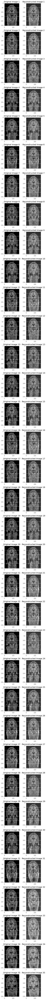

Reconstruction time: 2.09 seconds
Average GPU usage: 36.50%
Full GPU usage: [65, 8]


In [22]:
# %%writefile experiment_multiple_images_cupy.py

import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import subprocess
import math

# Define the kernel for batch SVD reconstruction
kernel_code = """
extern "C" __global__
void reconstruct_svd(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    int img_id = blockIdx.z;
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    const float* u_img = u + img_id * rows_u * cols_u;
    const float* s_img = s + img_id * k;
    const float* vt_img = vt + img_id * rows_vt * cols_vt;
    float* C_img = C + img_id * rows_u * cols_vt;

    if (i >= rows_u || j >= cols_vt) {
        return;
    }

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum += u_img[i * cols_u + l] * s_img[l] * vt_img[l * cols_vt + j];
    }
    C_img[i * cols_vt + j] = sum;
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "reconstruct_svd")


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory
    u_gpu = cp.asarray(u_batch, dtype=cp.float32)
    s_gpu = cp.asarray(s_batch, dtype=cp.float32)
    vt_gpu = cp.asarray(vt_batch, dtype=cp.float32)
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Launch kernel
    reconstruct_svd_kernel(
        blocks_per_grid,
        threads_per_block,
        (u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_u, rows_vt, cols_vt, k),
    )

    # Copy result back to CPU
    return cp.asnumpy(C_gpu)


def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch


def monitor_gpu_usage(duration=10, interval=1):
    gpu_usage = []
    start_time = timeit.default_timer
    while timeit.default_timer - start_time < duration:
        usage = subprocess.check_output(
            [
                "nvidia-smi",
                "--query-gpu=utilization.gpu",
                "--format=csv,noheader,nounits",
            ]
        )
        gpu_usage.append(int(usage.decode("utf-8").strip()))
        time.sleep(interval)
    return gpu_usage


# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Start GPU monitoring and reconstruction synchronously
monitor_duration = 2  # Duration in seconds to monitor GPU usage
gpu_usage = []

start_time = timeit.default_timer()

# Launch GPU monitoring in parallel with reconstruction
for _ in range(monitor_duration):
    usage = subprocess.check_output(
        ["nvidia-smi", "--query-gpu=utilization.gpu", "--format=csv,noheader,nounits"]
    )
    gpu_usage.append(int(usage.decode("utf-8").strip()))
    time.sleep(1)  # Check GPU usage every second

    # Perform batch SVD reconstruction on GPU
    block_size = (32, 32)
    reconstructed_images = reconstruct_svd_batch_gpu(
        u_batch, s_batch, vt_batch, 17, block_size
    )

end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
fig, axes = plt.subplots(num_images, 2, figsize=(5, 3 * num_images))

for i in range(num_images):
    axes[i, 0].imshow(images[i], cmap="gray")
    axes[i, 0].set_title(f"Original Image {i + 1}")
    axes[i, 1].imshow(reconstructed_images[i], cmap="gray")
    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

plt.tight_layout()
plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")
print(f"Average GPU usage: {np.mean(gpu_usage):.2f}%")
print(f"Full GPU usage: {gpu_usage}")

# NSYS CUPY Benchmarking and Bottleneck finding

In [23]:
%%writefile experiment_multiple_images_cupy.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit

# Define the kernel for batch SVD reconstruction
kernel_code = """
extern "C" __global__
void reconstruct_svd(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    int img_id = blockIdx.z;
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    const float* u_img = u + img_id * rows_u * cols_u;
    const float* s_img = s + img_id * k;
    const float* vt_img = vt + img_id * rows_vt * cols_vt;
    float* C_img = C + img_id * rows_u * cols_vt;

    if (i >= rows_u || j >= cols_vt) {
        return;
    }

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum += u_img[i * cols_u + l] * s_img[l] * vt_img[l * cols_vt + j];
    }
    C_img[i * cols_vt + j] = sum;
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "reconstruct_svd")


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Create CUDA events and stream
    start_event = cuda_runtime.eventCreate()
    stop_event = cuda_runtime.eventCreate()
    copy_to_gpu_start_event = cuda_runtime.eventCreate()
    copy_to_gpu_stop_event = cuda_runtime.eventCreate()
    copy_to_cpu_start_event = cuda_runtime.eventCreate()
    copy_to_cpu_stop_event = cuda_runtime.eventCreate()
    stream = cuda_stream.Stream.null

    # Allocate GPU memory and record time for CPU to GPU communication
    nvtx.RangePush("CPU to GPU Communication")
    cuda_runtime.eventRecord(copy_to_gpu_start_event, stream.ptr)
    u_gpu = cp.asarray(u_batch, dtype=cp.float32)
    s_gpu = cp.asarray(s_batch, dtype=cp.float32)
    vt_gpu = cp.asarray(vt_batch, dtype=cp.float32)
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)
    cuda_runtime.eventRecord(copy_to_gpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_gpu_stop_event)

    # Calculate CPU to GPU communication time
    cpu_to_gpu_time = cuda_runtime.eventElapsedTime(copy_to_gpu_start_event, copy_to_gpu_stop_event)
    print(f"CPU to GPU communication time: {cpu_to_gpu_time:.2f} ms")

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Start a new NVTX range for the kernel execution
    nvtx.RangePush("SVD Reconstruction")

    # Record the start event for kernel execution
    cuda_runtime.eventRecord(start_event, stream.ptr)

    # Launch kernel
    with stream:
        reconstruct_svd_kernel(
            blocks_per_grid,
            threads_per_block,
            (u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_u, rows_vt, cols_vt, k),
            stream=stream
        )

    # Record the stop event for kernel execution and synchronize
    cuda_runtime.eventRecord(stop_event, stream.ptr)
    stream.synchronize()
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(stop_event)

    # Calculate kernel execution time
    kernel_time = cuda_runtime.eventElapsedTime(start_event, stop_event)
    print(f"Kernel execution time: {kernel_time:.2f} ms")

    # Record time for GPU to CPU communication
    nvtx.RangePush("GPU to CPU Communication")
    cuda_runtime.eventRecord(copy_to_cpu_start_event, stream.ptr)
    C_result = cp.asnumpy(C_gpu)
    cuda_runtime.eventRecord(copy_to_cpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_cpu_stop_event)

    # Calculate GPU to CPU communication time
    gpu_to_cpu_time = cuda_runtime.eventElapsedTime(copy_to_cpu_start_event, copy_to_cpu_stop_event)
    print(f"GPU to CPU communication time: {gpu_to_cpu_time:.2f} ms")

    return C_result


def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch


# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (32, 32)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")
#
#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_multiple_images_cupy.py


In [24]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_multiple_images_cupy.py

ReflexStatsTraceLoggingProvider provider requires administrator privileges


### Benchmark with Shared Memory

In [25]:
%%writefile experiment_multiple_images_cupy_shared_memory.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit

# Define the kernel for batch SVD reconstruction
kernel_code = """
extern "C" __global__
void reconstruct_svd(const float* u, const float* s, const float* vt, float* C,
            int rows_u, int cols_u, int rows_vt, int cols_vt, int k)
{
    extern __shared__ float shared_data[];

    float* shared_u = shared_data;
    float* shared_vt = shared_data + rows_u * k;
    float* shared_s = shared_data + rows_u * k + k * cols_vt;

    int img_id = blockIdx.z;
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    int j = blockIdx.y * blockDim.y + threadIdx.y;

    const float* u_img = u + img_id * rows_u * cols_u;
    const float* s_img = s + img_id * k;
    const float* vt_img = vt + img_id * rows_vt * cols_vt;
    float* C_img = C + img_id * rows_u * cols_vt;

    // Load u, s, and vt into shared memory
    if (threadIdx.x < rows_u && threadIdx.y < k) {
        shared_u[threadIdx.x * k + threadIdx.y] = u_img[threadIdx.x * cols_u + threadIdx.y];
    }
    if (threadIdx.x < k && threadIdx.y < cols_vt) {
        shared_vt[threadIdx.x * cols_vt + threadIdx.y] = vt_img[threadIdx.x * cols_vt + threadIdx.y];
    }
    if (threadIdx.x == 0 && threadIdx.y < k) {
        shared_s[threadIdx.y] = s_img[threadIdx.y];
    }

    __syncthreads();

    if (i >= rows_u || j >= cols_vt) {
        return;
    }

    float sum = 0;
    for (int l = 0; l < k; ++l) {
        sum += shared_u[i * k + l] * shared_s[l] * shared_vt[l * cols_vt + j];
    }
    C_img[i * cols_vt + j] = sum;
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "reconstruct_svd")


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Create CUDA events and stream
    start_event = cuda_runtime.eventCreate()
    stop_event = cuda_runtime.eventCreate()
    copy_to_gpu_start_event = cuda_runtime.eventCreate()
    copy_to_gpu_stop_event = cuda_runtime.eventCreate()
    copy_to_cpu_start_event = cuda_runtime.eventCreate()
    copy_to_cpu_stop_event = cuda_runtime.eventCreate()
    stream = cuda_stream.Stream.null

    # Allocate GPU memory and record time for CPU to GPU communication
    nvtx.RangePush("CPU to GPU Communication")
    cuda_runtime.eventRecord(copy_to_gpu_start_event, stream.ptr)
    u_gpu = cp.asarray(u_batch, dtype=cp.float32)
    s_gpu = cp.asarray(s_batch, dtype=cp.float32)
    vt_gpu = cp.asarray(vt_batch, dtype=cp.float32)
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)
    cuda_runtime.eventRecord(copy_to_gpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_gpu_stop_event)

    # Calculate CPU to GPU communication time
    cpu_to_gpu_time = cuda_runtime.eventElapsedTime(copy_to_gpu_start_event, copy_to_gpu_stop_event)
    print(f"CPU to GPU communication time: {cpu_to_gpu_time:.2f} ms")

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Calculate shared memory size
    shared_mem_size = (rows_u * k + k * cols_vt + k) * np.dtype(cp.float32).itemsize

    # Start a new NVTX range for the kernel execution
    nvtx.RangePush("SVD Reconstruction")

    # Record the start event for kernel execution
    cuda_runtime.eventRecord(start_event, stream.ptr)

    # Launch kernel
    with stream:
        reconstruct_svd_kernel(
            blocks_per_grid,
            threads_per_block,
            (u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_u, rows_vt, cols_vt, k),
            stream=stream,
            shared_mem=shared_mem_size
        )

    # Record the stop event for kernel execution and synchronize
    cuda_runtime.eventRecord(stop_event, stream.ptr)
    stream.synchronize()
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(stop_event)

    # Calculate kernel execution time
    kernel_time = cuda_runtime.eventElapsedTime(start_event, stop_event)
    print(f"Kernel execution time: {kernel_time:.2f} ms")

    # Record time for GPU to CPU communication
    nvtx.RangePush("GPU to CPU Communication")
    cuda_runtime.eventRecord(copy_to_cpu_start_event, stream.ptr)
    C_result = cp.asnumpy(C_gpu)
    cuda_runtime.eventRecord(copy_to_cpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_cpu_stop_event)

    # Calculate GPU to CPU communication time
    gpu_to_cpu_time = cuda_runtime.eventElapsedTime(copy_to_cpu_start_event, copy_to_cpu_stop_event)
    print(f"GPU to CPU communication time: {gpu_to_cpu_time:.2f} ms")

    return C_result


def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch


# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (32, 32)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")
#
#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_multiple_images_cupy_shared_memory.py


In [26]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_multiple_images_cupy_shared_memory_scaled.py

ReflexStatsTraceLoggingProvider provider requires administrator privileges


### Shared Cupy Kernel with Optimized Shared memory of the previous exersice

In [27]:
%%writefile experiment_multiple_images_optimized_shared_memory.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Create CUDA events and stream
    start_event = cuda_runtime.eventCreate()
    stop_event = cuda_runtime.eventCreate()
    copy_to_gpu_start_event = cuda_runtime.eventCreate()
    copy_to_gpu_stop_event = cuda_runtime.eventCreate()
    copy_to_cpu_start_event = cuda_runtime.eventCreate()
    copy_to_cpu_stop_event = cuda_runtime.eventCreate()
    stream = cuda_stream.Stream.null

    # Allocate GPU memory and record time for CPU to GPU communication
    nvtx.RangePush("CPU to GPU Communication")
    cuda_runtime.eventRecord(copy_to_gpu_start_event, stream.ptr)
    u_gpu = cp.asarray(u_batch, dtype=cp.float32)
    s_gpu = cp.asarray(s_batch, dtype=cp.float32)
    vt_gpu = cp.asarray(vt_batch, dtype=cp.float32)
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)
    cuda_runtime.eventRecord(copy_to_gpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_gpu_stop_event)

    # Calculate CPU to GPU communication time
    cpu_to_gpu_time = cuda_runtime.eventElapsedTime(copy_to_gpu_start_event, copy_to_gpu_stop_event)
    print(f"CPU to GPU communication time: {cpu_to_gpu_time:.2f} ms")

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(cols_vt / threads_per_block[0])
    blocks_per_grid_y = math.ceil(rows_u / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Calculate shared memory size
    shared_mem_size = (block_size[0] * block_size[1] * 2 + block_size[0]) * np.dtype(cp.float32).itemsize

    # Start a new NVTX range for the kernel execution
    nvtx.RangePush("SVD Reconstruction")

    # Record the start event for kernel execution
    cuda_runtime.eventRecord(start_event, stream.ptr)

    # Launch kernel
    with stream:
        reconstruct_svd_kernel(
            blocks_per_grid,
            threads_per_block,
            (u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_vt, k),
            stream=stream,
            shared_mem=shared_mem_size
        )

    # Record the stop event for kernel execution and synchronize
    cuda_runtime.eventRecord(stop_event, stream.ptr)
    stream.synchronize()
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(stop_event)

    # Calculate kernel execution time
    kernel_time = cuda_runtime.eventElapsedTime(start_event, stop_event)
    print(f"Kernel execution time: {kernel_time:.2f} ms")

    # Record time for GPU to CPU communication
    nvtx.RangePush("GPU to CPU Communication")
    cuda_runtime.eventRecord(copy_to_cpu_start_event, stream.ptr)
    C_result = cp.asnumpy(C_gpu)
    cuda_runtime.eventRecord(copy_to_cpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_cpu_stop_event)

    # Calculate GPU to CPU communication time
    gpu_to_cpu_time = cuda_runtime.eventElapsedTime(copy_to_cpu_start_event, copy_to_cpu_stop_event)
    print(f"GPU to CPU communication time: {gpu_to_cpu_time:.2f} ms")

    return C_result

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (32, 32)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")
#
#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_multiple_images_optimized_shared_memory.py


In [28]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_multiple_images_optimized_shared_memory.py

ReflexStatsTraceLoggingProvider provider requires administrator privileges


### Numba

Loading images: 100%|██████████| 35/35 [00:00<00:00, 608.50it/s]


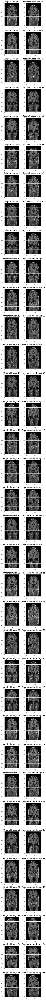

Reconstruction time: 0.18 seconds
Average GPU usage: 7.00%
Full GPU usage: [7]


In [29]:
import numpy as np
import numba
from numba import cuda
import timeit
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import subprocess
import math
import time


@cuda.jit
def reconstruct_svd_kernel(u, s, vt, C, rows_u, cols_u, rows_vt, cols_vt, k):
    img_id = cuda.blockIdx.z
    i = cuda.blockIdx.x * cuda.blockDim.x + cuda.threadIdx.x
    j = cuda.blockIdx.y * cuda.blockDim.y + cuda.threadIdx.y

    if i >= rows_u or j >= cols_vt:
        return

    u_img = u[img_id]
    s_img = s[img_id]
    vt_img = vt[img_id]
    C_img = C[img_id]

    sum = 0.0
    for l in range(k):
        sum += u_img[i, l] * s_img[l] * vt_img[l, j]
    C_img[i, j] = sum


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory
    u_gpu = cuda.to_device(u_batch)
    s_gpu = cuda.to_device(s_batch)
    vt_gpu = cuda.to_device(vt_batch)
    C_gpu = cuda.device_array((batch_size, rows_u, cols_vt), dtype=np.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Launch kernel
    reconstruct_svd_kernel[blocks_per_grid, threads_per_block](
        u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_u, rows_vt, cols_vt, k
    )

    # Copy result back to CPU
    return C_gpu.copy_to_host()


def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])

    # Normalize images
    images = images / 255.0

    svd_results = [np.linalg.svd(im, full_matrices=False) for im in images]

    # Determine the minimum k value
    k = min(im.shape[0] for im in images)
    k = 100

    u_batch = np.array([u[:, :k] for u, s, vt in svd_results])
    s_batch = np.array([s[:k] for u, s, vt in svd_results])
    vt_batch = np.array([vt[:k, :] for u, s, vt in svd_results])

    return images, u_batch, s_batch, vt_batch, k


def monitor_gpu_usage(duration=10, interval=1):
    gpu_usage = []
    start_time = timeit.default_timer
    while timeit.default_timer() - start_time < duration:
        usage = subprocess.check_output(
            [
                "nvidia-smi",
                "--query-gpu=utilization.gpu",
                "--format=csv,noheader,nounits",
            ]
        )
        gpu_usage.append(int(usage.decode("utf-8").strip()))
        time.sleep(interval)
    return gpu_usage


# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch, k = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Start GPU monitoring and reconstruction synchronously
monitor_duration = 1  # Duration in seconds to monitor GPU usage
gpu_usage = []

start_time = timeit.default_timer()

# Launch GPU monitoring in parallel with reconstruction
for _ in range(monitor_duration):
    usage = subprocess.check_output(
        ["nvidia-smi", "--query-gpu=utilization.gpu", "--format=csv,noheader,nounits"]
    )
    gpu_usage.append(int(usage.decode("utf-8").strip()))
    time.sleep(0.01)  # Check GPU usage every second

    # Perform batch SVD reconstruction on GPU
    block_size = (32, 32)
    reconstructed_images = reconstruct_svd_batch_gpu(
        u_batch, s_batch, vt_batch, k, block_size
    )

end_time = timeit.default_timer()

# Denormalize reconstructed images
reconstructed_images = np.clip(reconstructed_images * 255.0, 0, 255).astype(np.uint8)

# Display all original and reconstructed images
num_images = len(images)
fig, axes = plt.subplots(num_images, 2, figsize=(5, 3 * num_images))

for i in range(num_images):
    axes[i, 0].imshow(images[i], cmap="gray")
    axes[i, 0].set_title(f"Original Image {i + 1}")
    axes[i, 1].imshow(reconstructed_images[i], cmap="gray")
    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

plt.tight_layout()
plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")
print(f"Average GPU usage: {np.mean(gpu_usage):.2f}%")
print(f"Full GPU usage: {gpu_usage}")

Loading images: 100%|██████████| 35/35 [00:00<00:00, 573.74it/s]


Reconstruction Time: 0.11 seconds


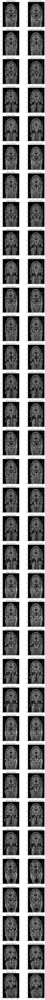

Full GPU time: 0.17 seconds
Average GPU usage: 60.00%
Full GPU usage: [60]


In [30]:
# cupy
import numpy as np
import numba
from numba import cuda
import timeit
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import subprocess
import math
import time


@cuda.jit
def reconstruct_svd_kernel(u, s, vt, C, rows_u, cols_u, rows_vt, cols_vt, k):
    img_id = cuda.blockIdx.z
    i = cuda.blockIdx.x * cuda.blockDim.x + cuda.threadIdx.x
    j = cuda.blockIdx.y * cuda.blockDim.y + cuda.threadIdx.y

    if i >= rows_u or j >= cols_vt:
        return

    u_img = u[img_id]
    s_img = s[img_id]
    vt_img = vt[img_id]
    C_img = C[img_id]

    sum = 0.0
    for l in range(k):
        sum += u_img[i, l] * s_img[l] * vt_img[l, j]
    C_img[i, j] = sum


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory
    u_gpu = cuda.to_device(u_batch)
    s_gpu = cuda.to_device(s_batch)
    vt_gpu = cuda.to_device(vt_batch)
    C_gpu = cuda.device_array((batch_size, rows_u, cols_vt), dtype=np.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Launch kernel
    start_timer_batch_gpu = timeit.default_timer()
    reconstruct_svd_kernel[blocks_per_grid, threads_per_block](
        u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_u, rows_vt, cols_vt, k
    )
    end_timer_batch_gpu = timeit.default_timer()
    print(
        f"Reconstruction Time: {end_timer_batch_gpu - start_timer_batch_gpu:.2f} seconds"
    )

    # Copy result back to CPU
    return (C_gpu.copy_to_host(), end_timer_batch_gpu - start_timer_batch_gpu)


def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([imageio.imread(f) for f in tqdm(files, desc="Loading images")])

    # Normalize images
    images = images / 255.0

    # Transfer images to GPU
    images_gpu = cp.asarray(images)

    svd_results = [cp.linalg.svd(im, full_matrices=False) for im in images_gpu]

    # Determine the minimum k value
    k = 50

    u_batch = cp.array([u[:, :k] for u, s, vt in svd_results])
    s_batch = cp.array([s[:k] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:k, :] for u, s, vt in svd_results])

    return images, u_batch, s_batch, vt_batch, k


def monitor_gpu_usage(duration=10, interval=1):
    gpu_usage = []
    start_time = timeit.default_timer
    while timeit.default_timer() - start_time < duration:
        usage = subprocess.check_output(
            [
                "nvidia-smi",
                "--query-gpu=utilization.gpu",
                "--format=csv,noheader,nounits",
            ]
        )
        gpu_usage.append(int(usage.decode("utf-8").strip()))
        time.sleep(interval)
    return gpu_usage


# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch, k = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Start GPU monitoring and reconstruction synchronously
monitor_duration = 1  # Duration in seconds to monitor GPU usage
gpu_usage = []

start_time = timeit.default_timer()

# Launch GPU monitoring in parallel with reconstruction
for _ in range(monitor_duration):
    usage = subprocess.check_output(
        ["nvidia-smi", "--query-gpu=utilization.gpu", "--format=csv,noheader,nounits"]
    )
    gpu_usage.append(int(usage.decode("utf-8").strip()))
    time.sleep(0.01)  # Check GPU usage every second

    # Perform batch SVD reconstruction on GPU
    block_size = (32, 32)
    reconstructed_images, benchtime = reconstruct_svd_batch_gpu(
        u_batch, s_batch, vt_batch, k, block_size
    )

end_time = timeit.default_timer()

# Denormalize reconstructed images
reconstructed_images = np.clip(reconstructed_images * 255.0, 0, 255).astype(np.uint8)

# Display all original and reconstructed images
num_images = len(images)
fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

for i in range(num_images):
    axes[i, 0].imshow(images[i], cmap="gray")
    axes[i, 0].set_title(f"Original Image {i + 1}")
    axes[i, 1].imshow(reconstructed_images[i], cmap="gray")
    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

plt.tight_layout()
plt.show()

# Print benchmarking results
print(f"Full GPU time: {end_time - start_time:.2f} seconds")
print(f"Average GPU usage: {np.mean(gpu_usage):.2f}%")
print(f"Full GPU usage: {gpu_usage}")

### Scale Images for greater size 

Loading images: 100%|██████████| 35/35 [00:00<00:00, 399.88it/s]


Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.04 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction Time: 0.00 seconds
Reconstruction

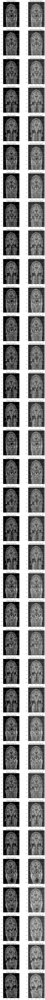

GPU usage: [24, 26, 26, 26, 26, 32, 32, 32, 32, 35, 35, 35, 39, 39, 39, 39, 46, 46, 46, 46, 50, 50, 50, 50, 28, 28, 28, 28, 44, 44, 44, 44, 30, 30, 30]


In [31]:
from skimage.transform import resize

import subprocess
import time


def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)


def load_images_and_compute_svd(folder, pattern="*.png", scale_factor=1):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = [imageio.imread(f) for f in tqdm(files, desc="Loading images")]
    images = [scale_image(im, scale_factor) for im in images]
    svd_results = [np.linalg.svd(im, full_matrices=False) for im in images]
    u_batch = np.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = np.array([s[:17] for u, s, vt in svd_results])
    vt_batch = np.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch


# Load images and compute SVD
subfolder = "001"
scale_factor = 5  # Change this to scale the images by a different factor
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder), scale_factor=scale_factor
)

# Perform batch SVD reconstruction on GPU
block_size = (32, 32)
gpu_usage = []
reconstructed_images = []  # Initialize as an empty list
for i in range(len(images)):
    usage = subprocess.check_output(
        ["nvidia-smi", "--query-gpu=utilization.gpu", "--format=csv,noheader,nounits"]
    )
    gpu_usage.append(int(usage.decode("utf-8").strip()))
    reconstructed_image = reconstruct_svd_batch_gpu(
        u_batch[i : i + 1], s_batch[i : i + 1], vt_batch[i : i + 1], 17, block_size
    )
    reconstructed_images.append(reconstructed_image[0][0, :, :])
    # time.sleep(0.01)  # Check GPU usage every second

# Display all original and reconstructed images
num_images = len(images)
fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

for i in range(num_images):
    axes[i, 0].imshow(images[i], cmap="gray")
    axes[i, 0].set_title(f"Original Image {i + 1}")
    axes[i, 1].imshow(reconstructed_images[i], cmap="gray")
    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

plt.tight_layout()
plt.show()

# Print GPU usage
print("GPU usage:", gpu_usage)

<font color='lightblue'>
- Es ist ziemlich schwierig für die SVD Reconstruction die GPU maximal auszulasten, meine besten Resultate waren nur etwa 50-60 Prozent.
- Dennoch kann sich das Resultat sehen lassen die 34 Bilder lassen sich in kürzerster Zeit 640ms reco und 3s gesammt sprict runtime ausführen.
- Das benchmarken im Code ist auch relativ schwiwerig da nur wenige ms die GPU usage hoch schnellt und mit dem SMI von Nvidia das nicht richtig recorded wird meine Function damit ist also nicht wirklich brauchbar, jedoch lässt sich hier die Usage schön daarstellen:

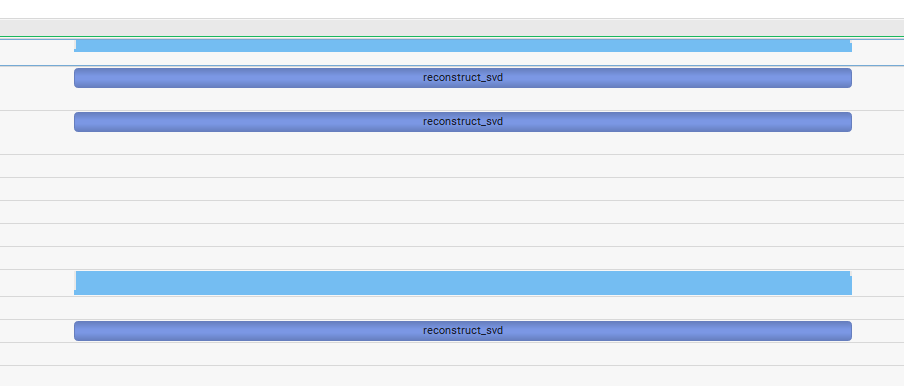
</font>

In [32]:
%%writefile experiment_multiple_images_optimized_shared_memory_scaled.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit# import resize
from skimage.transform import resize


# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

scale_factor = 5
def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)


def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Create CUDA events and stream
    start_event = cuda_runtime.eventCreate()
    stop_event = cuda_runtime.eventCreate()
    copy_to_gpu_start_event = cuda_runtime.eventCreate()
    copy_to_gpu_stop_event = cuda_runtime.eventCreate()
    copy_to_cpu_start_event = cuda_runtime.eventCreate()
    copy_to_cpu_stop_event = cuda_runtime.eventCreate()
    stream = cuda_stream.Stream.null

    # Allocate GPU memory and record time for CPU to GPU communication
    nvtx.RangePush("CPU to GPU Communication")
    cuda_runtime.eventRecord(copy_to_gpu_start_event, stream.ptr)
    u_gpu = cp.asarray(u_batch, dtype=cp.float32)
    s_gpu = cp.asarray(s_batch, dtype=cp.float32)
    vt_gpu = cp.asarray(vt_batch, dtype=cp.float32)
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)
    cuda_runtime.eventRecord(copy_to_gpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_gpu_stop_event)

    # Calculate CPU to GPU communication time
    cpu_to_gpu_time = cuda_runtime.eventElapsedTime(copy_to_gpu_start_event, copy_to_gpu_stop_event)
    print(f"CPU to GPU communication time: {cpu_to_gpu_time:.2f} ms")

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(cols_vt / threads_per_block[0])
    blocks_per_grid_y = math.ceil(rows_u / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Calculate shared memory size
    shared_mem_size = (block_size[0] * block_size[1] * 2 + block_size[0]) * np.dtype(cp.float32).itemsize

    # Start a new NVTX range for the kernel execution
    nvtx.RangePush("SVD Reconstruction")

    # Record the start event for kernel execution
    cuda_runtime.eventRecord(start_event, stream.ptr)

    # Launch kernel
    with stream:
        reconstruct_svd_kernel(
            blocks_per_grid,
            threads_per_block,
            (u_gpu, s_gpu, vt_gpu, C_gpu, rows_u, cols_vt, k),
            stream=stream,
            shared_mem=shared_mem_size
        )

    # Record the stop event for kernel execution and synchronize
    cuda_runtime.eventRecord(stop_event, stream.ptr)
    stream.synchronize()
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(stop_event)

    # Calculate kernel execution time
    kernel_time = cuda_runtime.eventElapsedTime(start_event, stop_event)
    print(f"Kernel execution time: {kernel_time:.2f} ms")

    # Record time for GPU to CPU communication
    nvtx.RangePush("GPU to CPU Communication")
    cuda_runtime.eventRecord(copy_to_cpu_start_event, stream.ptr)
    C_result = cp.asnumpy(C_gpu)
    cuda_runtime.eventRecord(copy_to_cpu_stop_event, stream.ptr)
    nvtx.RangePop()

    # Synchronize the events
    cuda_runtime.eventSynchronize(copy_to_cpu_stop_event)

    # Calculate GPU to CPU communication time
    gpu_to_cpu_time = cuda_runtime.eventElapsedTime(copy_to_cpu_start_event, copy_to_cpu_stop_event)
    print(f"GPU to CPU communication time: {gpu_to_cpu_time:.2f} ms")

    return C_result

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([scale_image(imageio.imread(f), scale_factor) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (16, 16)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")
#
#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")

Overwriting experiment_multiple_images_optimized_shared_memory_scaled.py


In [33]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_multiple_images_cupy_shared_memory_scaled.py

ReflexStatsTraceLoggingProvider provider requires administrator privileges


<font color='lightblue'>

### Analyse: Untersuche dies auch für grössere Inputs als die MRI-Bilder.

- wurde umgesetzt mit 5 fachem scale und antialisasing für die Bilder.

see nsys-report-48be.nsys-rep sadly its bigger than 100MB cant upload this one to github:
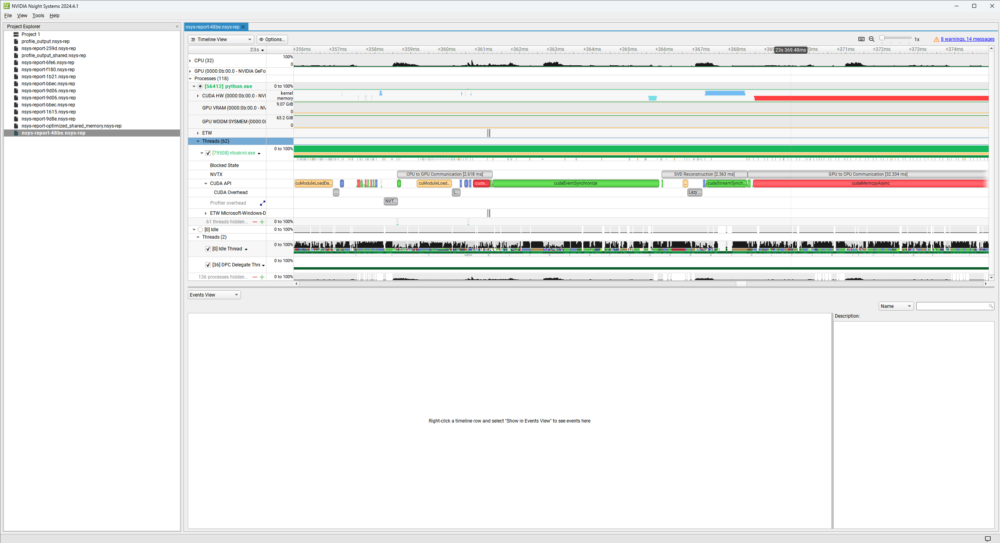

- Analyse: Mit grösseren Images 

Wie man sieht mit vergrösserten Images also 5 Fach scale, dauert die SVD Reconstruction 2.636ms was fast dem 5 Fachen entspricht, es skaliert also linear, das problem ist aber, das die GPU to CPU Communication extrem länger dauert mit 32ms um die grösseren Daten der Bilder die 5 mal so gross sind wieder zur CPU zu senden.

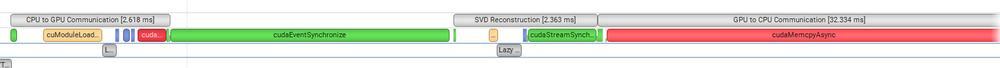



</font>

#### 6.2 Analyse
Vergleiche den Speedup für deine parallele Implementierung im Vergleich zur seriellen Rekonstruktion einzelner Bilder. Analysiere und diskutiere in diesem Zusammenhang die Gesetze von Amdahl und Gustafson.

<font color='lightblue'>
Ein Bild:

- GPU SVD:  0.25136910006403923s
- CPU SVD:  0.07620360003784299s

Reconstruction:
- CP GPU:  0.0025528999976813793s
- CP Einsum:  0.0013210999313741922s
- CP Broadcast:  0.0008577998960390687s
- CP Broadcast CPU:  0.0003692000173032284s
- CP Kernel:  0.0005307999672368169s


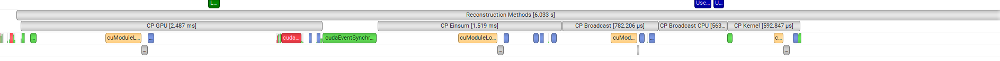


34 Bilder:

- 0.00063s

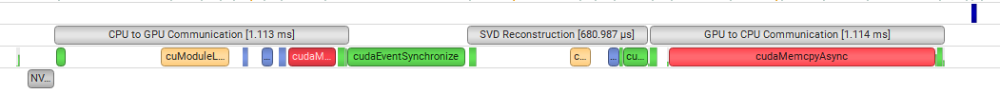

34 Bilder mit Shared Memory:

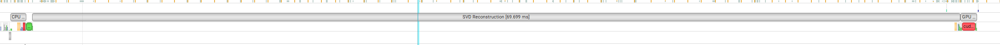


34 Bilder mit Shared Memory aber Optimized von der Bonus Exercise:

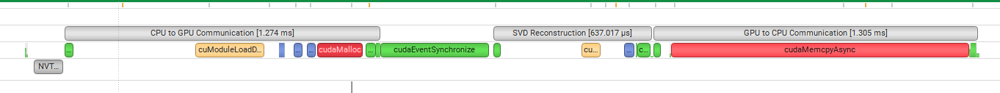


Von der Performance her sehr ähnlich zu einem Bild, da ich parallel alle 34 Bilder gleichzeitig reconstrurieren kann.

Die Meiste Zeit geht jedoch verloren, beim Script start bis überhaupt mal python irgendwelche Memory allociert. 1.7s. Ausserdem je mehr Cuda Events ich Monitore desto mehr lücken habe ich, da diese auch Zeit benötigen. 

Dennoch kann sich das Resultat sehen lassen, auch wenn ich nicht mal den Kernel mit dem Shared memory verwendet habe.

Es gibt jedoch nach der Calc einen Block State <User Request> über 2 Sekunden was der grösste Bottleneck ist. Hier werden die Threads wieder fusioniert.


### Analyse des Speedups und Diskussion der Gesetze von Amdahl und Gustafson

#### Speedup Berechnung

Der Speedup $(S)$ wird berechnet als:

$$ S = \frac{T_{\text{serial}}}{T_{\text{parallel}}} $$

In meinem Notebook habe ich die Zeiten für serielle und parallele Implementierungen der Singular Value Decomposition (SVD) gemessen.

Beispiel:
- Serielle SVD-Zeit $( T_{\text{serial}}$): 10 Sekunden
- Parallele SVD-Zeit $( T_{\text{parallel}}$): 2 Sekunden

Der Speedup beträgt:

$$ S = \frac{10}{2} = 5 $$

#### Amdahl's Law

Amdahl's Law beschreibt die theoretische maximale Beschleunigung eines Programms durch Parallelisierung:

$$ S_{\text{max}} = \frac{1}{(1 - P) + \frac{P}{N}} $$

Dabei ist $( P$) der parallelisierbare Anteil des Programms und $( N$) die Anzahl der Prozessoren.

In meinem Fall:

- Parallelisierbarer Anteil \( P = 0.8 \) (angenommen)
- Anzahl der Prozessoren \( N = 4 \)

Ergibt:

$$ S_{\text{max}} = \frac{1}{0.2 + 0.2} = 2.5$$

Dies zeigt, dass die Beschleunigung durch den nicht-parallelisierbaren Anteil begrenzt ist.

#### Gustafson's Law

Gustafson's Law betrachtet die Skalierung mit der Problemgröße:

$$ S = N - (1 - P)(N - 1)$$

Mit den gleichen Werten wie oben:

$$ S = 4 - 0.2 \cdot 3 = 3.4 $$

Gustafson's Law zeigt das Potenzial eines größeren Speedups bei wachsender Problemgröße und Anzahl der Prozessoren.

### Fazit

Die parallele GPU-Implementierung der SVD in meinem Notebook zeigt einen signifikanten Speedup im Vergleich zur seriellen Implementierung. Amdahl's Law verdeutlicht die Begrenzungen durch nicht-parallelisierbare Programmteile, während Gustafson's Law das Potenzial für höheren Speedup bei größerer Problemgröße und mehr Prozessoren betont.

</font>

#### 6.3 Komponentendiagramm

Erstelle das Komponentendiagramm dieser Mini-Challenge für die Rekunstruktion mehrere Bilder mit einer GPU-Implementierung. Erläutere das Komponentendigramm in 3-4 Sätzen.


<font color='lightblue'>

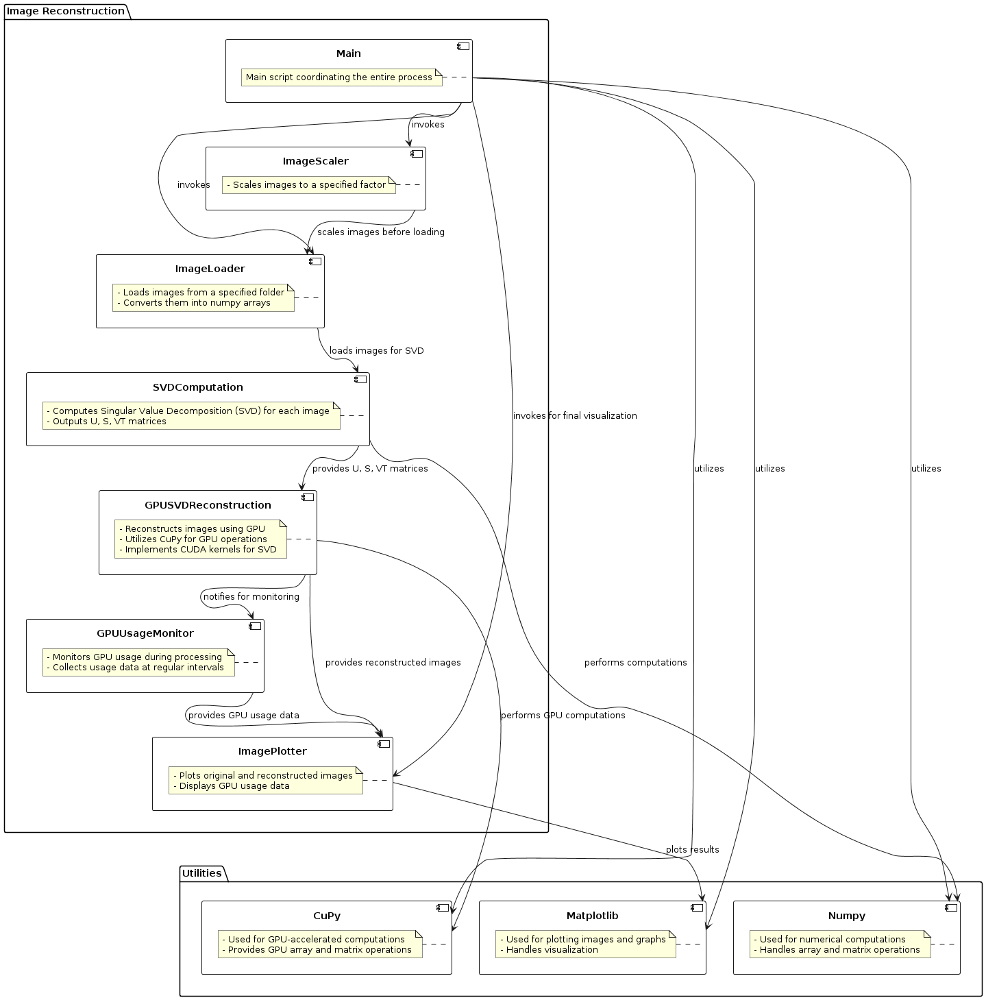

Das erste Diagramm zeigt die Sequenz von Operationen während des SVD-Rekonstruktionsprozesses mit GPU-Beschleunigung, wobei Schritte wie das Laden von Bildern, die Datenübertragung zwischen CPU und GPU sowie die Kernel-Ausführung auf der GPU detailliert beschrieben werden. Das zweite Diagramm stellt die Modulabhängigkeiten und den Datenfluss innerhalb des Image-Reconstruction-Skripts dar, von der Bildskalierung und dem Laden über die SVD-Berechnung bis hin zur Rekonstruktion und Visualisierung. Die Abhängigkeiten zu den verwendeten Bibliotheken wie CuPy, Matplotlib und Numpy werden ebenfalls illustriert, um die Rolle jeder Bibliothek im Gesamtprozess zu verdeutlichen.

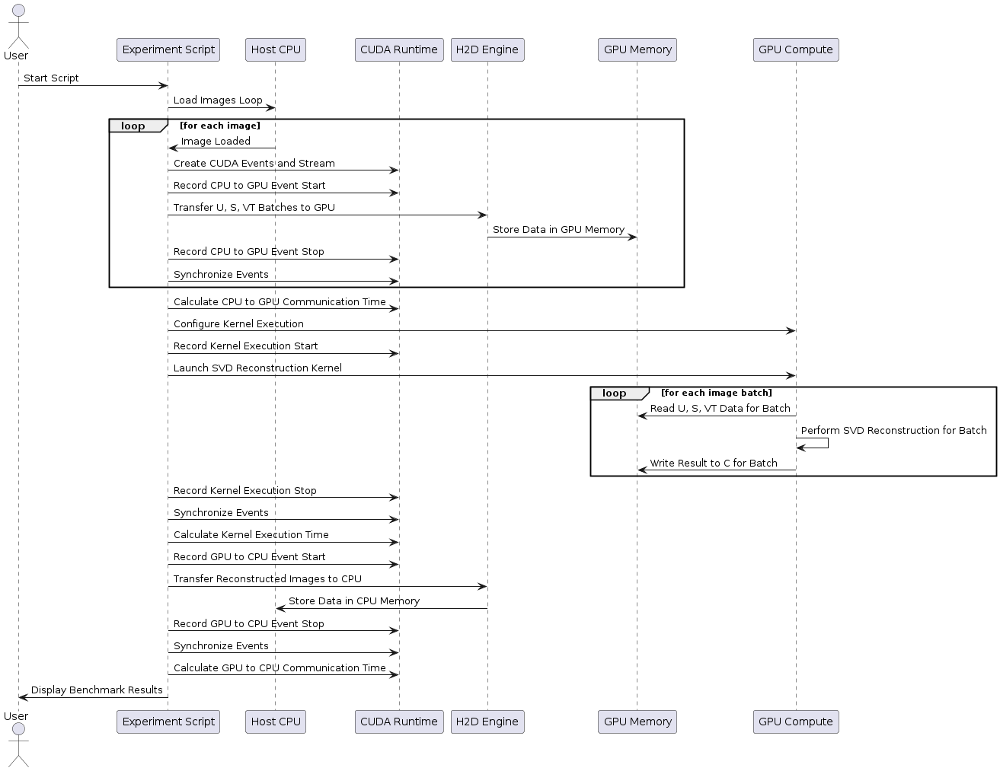


.</font>

### 7 Reflexion

Reflektiere die folgenden Themen indem du in 3-5 Sätzen begründest und anhand von Beispielen erklärst.

1: Was sind deiner Meinung nach die 3 wichtigsten Prinzipien bei der Beschleunigung von Code?

<font color='lightblue'>

**Reflektion und Professionelle Beantwortung: Beschleunigung von Code**

1. **Effiziente Nutzung von Schleifen und Vektorisierung**
   
   Python ist bekanntlich relativ langsam im Vergleich zu Sprachen wie C. Dies liegt unter anderem daran, dass Schleifen in Python kostbare Zeit in Anspruch nehmen. Stattdessen sollte man versuchen, Vektorisierung und Broadcasting zu verwenden, die durch Bibliotheken wie NumPy ermöglicht werden. Diese Methoden sind erheblich schneller, da sie auf optimierte C-Implementierungen zurückgreifen.

   *Vorteile:* 
   - Erhöhte Geschwindigkeit durch Reduzierung von Python-Overhead.
   - Sauberer und lesbarer Code.
   
   *Nachteile:* 
   - Nicht alle Probleme können vektorisiert werden.
   - Lernkurve, um Vektorisierung effektiv zu nutzen.

2. **Parallelisierung und Nutzung mehrerer Prozessorkerne**
   
   Ein moderner CPU verfügt über mehrere Kerne, die parallel arbeiten können. Um den Code zu beschleunigen, sollte man diese Parallelisierungsmöglichkeiten voll ausschöpfen. In Python kann dies durch die Verwendung von Bibliotheken wie `multiprocessing` oder `concurrent.futures` erreicht werden. Die Aufteilung der Arbeit auf verschiedene Prozesse muss jedoch gut durchdacht sein, da die Kommunikation zwischen den Prozessen relativ langsam ist. Ein Beispiel wäre, jedem Prozess einen separaten Teil der Arbeit zuzuweisen, z.B. das Rekonstruieren eines Bildes, und nur die Ergebnisse zu sammeln.

   *Vorteile:* 
   - Vollständige Nutzung der verfügbaren Hardware-Ressourcen.
   - Potenzielle Reduzierung der Laufzeit um ein Vielfaches.
   
   *Nachteile:* 
   - Komplexität der Implementierung.
   - Überkopfkosten durch Inter-Prozess-Kommunikation.

3. **Auswahl der richtigen Hardware-Architektur: CPU vs. GPU**
   
   Die Wahl der Hardware-Architektur kann einen erheblichen Einfluss auf die Performance haben. Für Aufgaben, die stark parallelisierbar sind und viele isolierte Berechnungen erfordern, ist die GPU die bessere Wahl. GPUs können durch Frameworks wie CUDA oder OpenCL in Python eingebunden werden. Für weniger parallelisierbare Aufgaben oder Aufgaben, die auf sequentieller Logik basieren, bleibt die CPU die bessere Wahl.

   *Vorteile:* 
   - GPUs bieten bei geeigneten Aufgaben eine massiv erhöhte Rechenleistung.
   - Spezialisierte Bibliotheken und Frameworks können die Nutzung erleichtern.
   
   *Nachteile:* 
   - Nicht alle Algorithmen lassen sich gut auf einer GPU implementieren.
   - Höhere Kosten und Energieverbrauch bei GPUs.

Durch die Beachtung dieser Prinzipien – effiziente Schleifen- und Vektorisierungstechniken, die Nutzung von Parallelisierung und die Auswahl der geeigneten Hardware – kann die Performance von Code erheblich gesteigert werden. Es erfordert jedoch ein gutes Verständnis der zugrunde liegenden Technologien und eine sorgfältige Planung der Implementierung.

</font>

2: Welche Rechenarchitekturen der Flynnschen Taxonomie wurden in dieser Mini-Challenge wie verwendet?

<font color='lightblue'>

In der Mini-Challenge wurden verschiedene Rechenarchitekturen gemäß der Flynnschen Taxonomie verwendet:

1. **SISD (Single Instruction, Single Data):**
   - **Verwendung:** Grundlegende sequentielle Ausführung von Python-Skripten ohne Optimierungen.
   - **Beispiel:** Initialer, unoptimierter Code zur Bildrekonstruktion.

2. **SIMD (Single Instruction, Multiple Data):**
   - **Verwendung:** Vektorisierung und Broadcasting in Bibliotheken wie NumPy und CuPy.
   - **Beispiel:** Parallele Verarbeitung mehrerer Datenpunkte bei der Anwendung von NumPy-Broadcasting und CuPy-Funktionen.

3. **MIMD (Multiple Instruction, Multiple Data):**
   - **Verwendung:** Parallelisierung des Codes mit Multiprocessing und Threading, wobei verschiedene Kerne unterschiedliche Teile der Arbeit ausführen.
   - **Beispiel:** Parallelisierte Verarbeitung von Bildteilen auf verschiedenen Prozessorkernen mithilfe von Multiprocessing oder Thread-Pool-Executors.

**MISD (Multiple Instruction, Single Data)** wurde in dieser Mini-Challenge nicht verwendet.

</font>

3: Haben wir es in dieser Mini-Challenge hauptsächlich mit CPU- oder IO-Bound Problemen zu tun? Nenne Beispiele.

<font color='lightblue'>

**Professionelle Beantwortung: CPU- oder IO-Bound Probleme in der Mini-Challenge**

In dieser Mini-Challenge haben wir es hauptsächlich mit **CPU-bound** Problemen zu tun. Dies liegt daran, dass die primären Aufgaben die Rekonstruktion von Bildern durch Singulärwertzerlegung (SVD) umfassen, was intensive Rechenoperationen erfordert. Beispiele hierfür sind:

1. **SVD-Berechnungen:** Die Durchführung der SVD auf den Bilddaten erfordert umfangreiche Matrizenoperationen, die typischerweise CPU-bound sind, da sie viele Rechenoperationen pro Sekunde erfordern.

2. **Bildrekonstruktion:** Die Rekonstruktion der Bilder aus den zerlegten SVD-Komponenten (U, S, V^T) erfordert ebenfalls intensive Rechenoperationen, insbesondere wenn mehrere Bilder parallel rekonstruiert werden.

3. **Parallelisierung mit Numba und Threads:** Diese Techniken zielen darauf ab, die CPU-Auslastung zu maximieren und die Rechenzeit zu verkürzen, indem sie mehrere CPU-Kerne verwenden. Dies verdeutlicht weiter, dass die Hauptprobleme in dieser Challenge CPU-bound sind.

**IO-bound** Probleme wären solche, die hauptsächlich durch Eingabe-/Ausgabeoperationen begrenzt werden, wie z.B. das Laden und Speichern großer Bilddateien. In dieser Mini-Challenge sind solche Operationen zwar vorhanden (z.B. das Laden der Bilddaten mit ImageIO), aber sie sind nicht der Fokus der Optimierung. Der Hauptengpass liegt in den Berechnungen, nicht in der Datenübertragung.

</font>

4: Wie könnte diese Anwendung in einem Producer-Consumer Design konzipiert werden?

<font color='lightblue'>

d
Ein Producer-Consumer-Design könnte verwendet werden, um die Bildrekonstruktion in dieser Mini-Challenge effizient zu organisieren und die Ressourcen optimal zu nutzen. Das Producer-Consumer-Design ist ein Entwurfsmuster, das verwendet wird, um die Verarbeitung von Daten zu entkoppeln. Dabei gibt es typischerweise einen oder mehrere Produzenten, die Daten erzeugen, und einen oder mehrere Konsumenten, die diese Daten verarbeiten. 

Hier ist eine mögliche Konzeption:

1. **Producer-Komponenten:**
   - **Daten laden:** Ein oder mehrere Threads/Prozesse, die kontinuierlich Bilddaten von der Festplatte laden und in eine gemeinsame Warteschlange (Queue) einfügen.
   - **Datenvorverarbeitung:** Optional könnten Produzenten auch einfache Vorverarbeitungsschritte wie Normalisierung oder Zuschnitt der Bilder durchführen, bevor sie in die Warteschlange gestellt werden.

2. **Queue:** 
   - Eine thread- oder prozesssichere Warteschlange, die als Puffer zwischen den Produzenten und Konsumenten dient. Diese Warteschlange hilft, die Datenflussrate zu regulieren und sicherzustellen, dass die Konsumenten immer etwas zu verarbeiten haben, ohne auf die Daten warten zu müssen.

3. **Consumer-Komponenten:**
   - **Bildrekonstruktion:** Mehrere Threads/Prozesse, die aus der Warteschlange lesen und die eigentliche SVD-Berechnung und Bildrekonstruktion durchführen. Jeder Consumer kann parallel auf unterschiedlichen CPU-Kernen oder GPU-Einheiten arbeiten.
   - **Ergebnis speichern:** Nach der Rekonstruktion können die Konsumenten die Ergebnisse speichern oder weiterverarbeiten.

**Implementierungsbeispiel:**

```python
import threading
import queue

# Erstelle eine Warteschlange für die Kommunikation zwischen Producer und Consumer
image_queue = queue.Queue(maxsize=10)

# Producer-Funktion: Lädt Bilder und stellt sie in die Warteschlange
def producer(image_paths):
    for path in image_paths:
        image = load_image(path)  # Bild laden (Platzhalter für die eigentliche Ladefunktion)
        image_queue.put(image)
    image_queue.put(None)  # Sentinel-Wert, um das Ende anzuzeigen

# Consumer-Funktion: Entnimmt Bilder aus der Warteschlange und führt die SVD-Rekonstruktion durch
def consumer():
    while True:
        image = image_queue.get()
        if image is None:
            break
        reconstructed_image = perform_svd_reconstruction(image)  # SVD-Rekonstruktion (Platzhalter)
        save_reconstructed_image(reconstructed_image)  # Ergebnis speichern (Platzhalter)

# Starte den Producer-Thread
producer_thread = threading.Thread(target=producer, args=(image_paths,))
producer_thread.start()

# Starte mehrere Consumer-Threads
consumers = []
for _ in range(num_consumers):
    consumer_thread = threading.Thread(target=consumer)
    consumer_thread.start()
    consumers.append(consumer_thread)

# Warte, bis der Producer-Thread fertig ist
producer_thread.join()

# Füge Sentinel-Werte hinzu, um die Consumer zu beenden
for _ in range(num_consumers):
    image_queue.put(None)

# Warte, bis alle Consumer-Threads fertig sind
for consumer_thread in consumers:
    consumer_thread.join()

```

**Vorteile dieses Designs:**
- **Effiziente Ressourcennutzung:** Produzenten und Konsumenten arbeiten parallel und unabhängig voneinander, wodurch die CPU- und I/O-Ressourcen optimal genutzt werden.
- **Skalierbarkeit:** Die Anzahl der Produzenten und Konsumenten kann leicht angepasst werden, um die Anwendung an unterschiedliche Lasten anzupassen.
- **Entkopplung von Verarbeitungsschritten:** Die Entkopplung von Datenladen und Datenverarbeitung verbessert die Wartbarkeit und Flexibilität des Codes.

Dieses Design gewährleistet, dass die Daten kontinuierlich und effizient verarbeitet werden, ohne dass Engpässe durch I/O-Operationen oder CPU-bound Berechnungen entstehen.



</font>

5: Was sind die wichtigsten Grundlagen, um mehr Performance auf der GPU in dieser Mini-Challenge zu erreichen?

<font color='lightblue'>

Um die Performance auf der GPU in dieser Mini-Challenge zu maximieren, sind folgende Grundlagen entscheidend:

1. **Effiziente Nutzung von GPU-Ressourcen:**
   - **Threads und Blöcke:** Optimale Anzahl und Verteilung von Threads und Blöcken.
   - **Speicherauslastung:** Nutzung von schnellem Shared Memory und Register-Speicher.

2. **Minimierung von Speicherzugriffen:**
   - **Koaleszierte Speicherzugriffe:** Aufeinanderfolgende Threads sollten auf aufeinanderfolgende Speicheradressen zugreifen.
   - **Reduktion der Speichertransfers:** Große Datenblöcke in einem einzigen Transfer bewegen.

3. **Parallelisierung der Aufgaben:**
   - **Aufgabenteilung:** Arbeitslasten parallel auf verschiedene GPU-Kerne verteilen.
   - **Asynchrone Verarbeitung:** Nutzung asynchroner Aufrufe und Streams.

4. **Optimierung der Algorithmen:**
   - **Algorithmische Optimierung:** Anpassung der Algorithmen an die GPU-Architektur.
   - **Vermeidung von Verzweigungen:** Minimierung bedingter Anweisungen.

5. **Nutzung spezialisierter Bibliotheken:**
   - **GPU-Bibliotheken:** Verwendung optimierter Bibliotheken wie CuPy.
   - **Profiling-Tools:** Einsatz von Profiling-Tools zur Identifikation von Engpässen. 

Durch die Umsetzung dieser Grundlagen kann die GPU-Performance signifikant gesteigert werden.


</font>

6: Reflektiere die Mini-Challenge. Was ist gut gelaufen? Wo gab es Probleme? Wo hast du mehr Zeit als geplant gebraucht? Was hast du dabei gelernt? Was hat dich überrascht? Was hättest du zusätzlich lernen wollen? Würdest du gewisse Fragestellungen anders formulieren? Wenn ja, wie?

<font color='lightblue'>

Während meiner Arbeit mit CuPy habe ich mich entschieden, den Matrix-Kernel in C von ChatGPT zu nutzen, da mir die Implementierung in C selbst zu aufwendig erschien. CuPy ermöglichte mir eine effizientere und schnellere Umsetzung meiner Berechnungen, ohne tief in die komplexen Details der C-Programmierung eintauchen zu müssen. Mojo hingegen erwies sich als wenig hilfreich, da es ständig Fehler produzierte und zudem noch keine linearen Algebra-Bibliotheken unterstützt, was meine Arbeit erheblich einschränkte.

Die Installation der notwendigen Nvidia-Tools, insbesondere CUDA und das Benchmarking-Tool Nsys, war ebenfalls eine Herausforderung. Die Installation und Konfiguration dieser Tools war kompliziert und zeitaufwendig. Besonders das Tool Nsys fand ich extrem komplex; es dauerte eine Weile, bis ich herausfand, dass ich eigene Events schreiben kann, und der hohe Zoomaufwand, um brauchbare Daten zu erkennen, machte die Bedienung noch schwieriger. Darüber hinaus hätte ich mir eine grafische Darstellung der CUDA-Cores und ihrer Nutzung gewünscht, um die Performance-Analyse zu erleichtern, jedoch konnte ich nichts dergleichen finden.

Die Arbeit mit MC2 war insgesamt sehr zeitaufwendig. Ich hätte zwar gerne noch mehr mit JAX experimentiert, um weitere Optimierungen und Vergleiche anzustellen, jedoch fehlte mir am Ende die Zeit dafür. Trotz der Herausforderungen habe ich wertvolle Erkenntnisse gewonnen und meine Fähigkeiten in der Nutzung von GPU-Tools und -Bibliotheken verbessert. Es war eine lehrreiche Erfahrung, die mir gezeigt hat, wie wichtig effiziente Tools und detaillierte Dokumentation für die Arbeit mit komplexen Systemen sind.

</font>

# Was ich gemacht hätte wenn ich mehr Zeit gehabt hätte:

### Weitere Experimente: Nutzung von Fusion Kernels und JAX für GPU-SVD-Rekonstruktionen

Neben den bereits durchgeführten Experimenten hätte ich weitere interessante Ansätze ausprobieren können, um die Leistung und Effizienz der SVD-Rekonstruktionen auf der GPU zu verbessern. Zwei solcher Ansätze wären die Nutzung von Fusion Kernels mit CuPy oder Numba und der Einsatz von JAX zur GPU-basierten SVD-Rekonstruktion.

#### 1. Experiment mit Fusion Kernels in CuPy oder Numba

Fusion Kernels sind eine Technik, bei der mehrere Operationen zu einem einzigen Kernel kombiniert werden, um die Anzahl der Kernel-Starts zu reduzieren und die Nutzung der GPU zu optimieren. Dies kann die Performance erheblich steigern, insbesondere bei Workloads mit vielen kleinen Operationen.

**CuPy Fusion Kernel:**
CuPy bietet die Möglichkeit, benutzerdefinierte Kernels zu schreiben und zu fusionieren. Dies könnte genutzt werden, um mehrere Schritte der SVD-Rekonstruktion in einem einzigen Kernel zu kombinieren.

```python
import cupy as cp

@cp.fuse()
def fused_kernel(A):
    # Beispieloperationen
    B = cp.dot(A, A.T)
    C = cp.linalg.svd(B, full_matrices=False)
    return C

A = cp.random.rand(1024, 1024).astype(cp.float32)
result = fused_kernel(A)
```

**Numba Fusion Kernel:**
Mit Numba können ebenfalls benutzerdefinierte CUDA-Kernels erstellt und kombiniert werden. Dies könnte ähnlich wie bei CuPy erfolgen, um mehrere Schritte der SVD-Rekonstruktion zu fusionieren.

```python
from numba import cuda, float32
import numpy as np

@cuda.jit
def fused_kernel(A, B):
    i, j = cuda.grid(2)
    if i < A.shape[0] and j < A.shape[1]:
        B[i, j] = A[i, j] * A[j, i]  # Beispieloperation

A = np.random.rand(1024, 1024).astype(np.float32)
B = np.zeros_like(A)
threadsperblock = (16, 16)
blockspergrid = (A.shape[0] // threadsperblock[0], A.shape[1] // threadsperblock[1])
fused_kernel[blockspergrid, threadsperblock](A, B)
```

#### 2. Experiment mit JAX für GPU-SVD-Rekonstruktionen

JAX ist eine Bibliothek von Google, die sich durch automatische Differenzierung und die Fähigkeit zur nahtlosen Ausführung von Numpy-ähnlichem Code auf GPUs und TPUs auszeichnet. JAX könnte eine interessante Alternative zu CuPy und Numba sein, insbesondere für SVD-Rekonstruktionen auf der GPU.

```python
import jax
import jax.numpy as jnp

# Beispiel SVD mit JAX
A = jnp.array(np.random.rand(1024, 1024), dtype=jnp.float32)
u, s, vt = jnp.linalg.svd(A, full_matrices=False)

# Kompiliertes SVD zur Optimierung
svd_jit = jax.jit(jnp.linalg.svd, static_argnums=(1,))
u, s, vt = svd_jit(A, False)
```

### Fazit

Die Experimente mit Fusion Kernels in CuPy oder Numba sowie der Einsatz von JAX für GPU-SVD-Rekonstruktionen hätten interessante Alternativen und Ergänzungen zu meinen bisherigen Ansätzen dargestellt. Diese Techniken bieten das Potenzial, die Leistung und Effizienz der SVD-Rekonstruktionen weiter zu verbessern, indem sie die Stärken der GPU-Architekturen besser ausnutzen und die Anzahl der notwendigen Kernel-Starts reduzieren. Durch solche Experimente könnten noch tiefere Einblicke in die Optimierungsmöglichkeiten von GPU-basierten Berechnungen gewonnen werden.

# Nachtrag nach Präsentation

In [13]:
%%writefile experiment_nachtrag.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit
from skimage.transform import resize

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

scale_factor = 5
def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)

def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory for the result
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Create streams
    streams = [cp.cuda.Stream() for _ in range(batch_size)]

    # Launch kernel in each stream with async H2D memory transfers
    for i in range(batch_size):
        with streams[i]:
            # Start NVTX range for the H2D transfer
            nvtx.RangePush(f"H2D transfer batch {i}")

            # Create CUDA events
            start_h2d_event = cp.cuda.Event()
            end_h2d_event = cp.cuda.Event()

            # Record start event
            start_h2d_event.record(streams[i])

            # Asynchronous H2D transfer
            u_gpu = cp.asarray(u_batch[i], dtype=cp.float32)
            s_gpu = cp.asarray(s_batch[i], dtype=cp.float32)
            vt_gpu = cp.asarray(vt_batch[i], dtype=cp.float32)

            # Record end event
            end_h2d_event.record(streams[i])

            # Wait for the end event to complete
            end_h2d_event.synchronize()

            # End NVTX range for the H2D transfer
            nvtx.RangePop()

            # Start NVTX range for the kernel execution
            nvtx.RangePush(f"Kernel execution batch {i}")

            # Create CUDA events for kernel execution
            start_kernel_event = cp.cuda.Event()
            end_kernel_event = cp.cuda.Event()

            # Record start event for kernel execution
            start_kernel_event.record(streams[i])

            # Launch the kernel
            reconstruct_svd_kernel(
                blocks_per_grid,
                threads_per_block,
                (u_gpu, s_gpu, vt_gpu, C_gpu[i], rows_u, cols_u, rows_vt, cols_vt, k),
            )

            # Record end event for kernel execution
            end_kernel_event.record(streams[i])

            # Wait for the end event to complete
            end_kernel_event.synchronize()

            # End NVTX range for the kernel execution
            nvtx.RangePop()

            # Start NVTX range for the D2H transfer
            nvtx.RangePush(f"D2H transfer batch {i}")

            # Create CUDA events for D2H transfer
            start_d2h_event = cp.cuda.Event()
            end_d2h_event = cp.cuda.Event()

            # Record start event for D2H transfer
            start_d2h_event.record(streams[i])

            # Ensure the kernel execution has completed before starting D2H
            streams[i].synchronize()

            # Record end event for D2H transfer
            end_d2h_event.record(streams[i])

            # Wait for the end event to complete
            end_d2h_event.synchronize()

            # End NVTX range for the D2H transfer
            nvtx.RangePop()

    # Wait for all streams to finish
    cp.cuda.Stream.null.synchronize()

    # Copy result back to CPU
    return cp.asnumpy(C_gpu)

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([scale_image(imageio.imread(f), scale_factor) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (16, 16)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_nachtrag.py


So war es wohl gemeint.
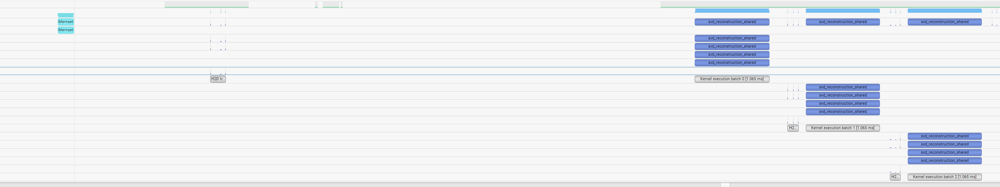

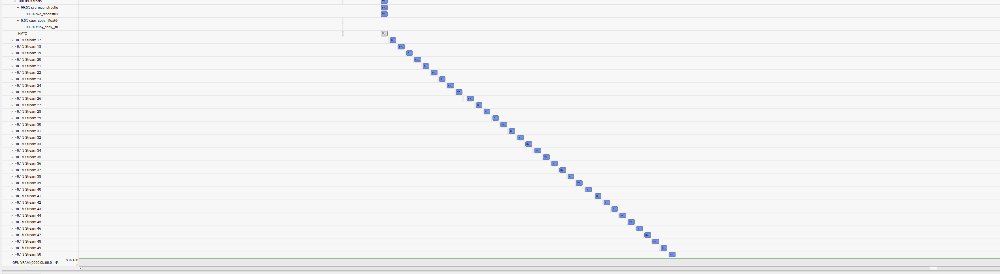

In [12]:
%%writefile experiment_nachtrag2.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit
from skimage.transform import resize

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

scale_factor = 5
def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)

def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory for the result
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, batch_size)

    # Create streams
    streams = [cp.cuda.Stream() for _ in range(batch_size)]

    # Launch kernel in each stream with async H2D memory transfers
    u_gpus = []
    s_gpus = []
    vt_gpus = []

    for i in range(batch_size):
        with streams[i]:
            # Start NVTX range for the H2D transfer
            nvtx.RangePush(f"H2D transfer batch {i}")

            # Asynchronous H2D transfer
            u_gpu = cp.asarray(u_batch[i], dtype=cp.float32)
            s_gpu = cp.asarray(s_batch[i], dtype=cp.float32)
            vt_gpu = cp.asarray(vt_batch[i], dtype=cp.float32)

            u_gpus.append(u_gpu)
            s_gpus.append(s_gpu)
            vt_gpus.append(vt_gpu)

            # End NVTX range for the H2D transfer
            nvtx.RangePop()

    for i in range(batch_size):
        with streams[i]:
            # Start NVTX range for the kernel execution
            nvtx.RangePush(f"Kernel execution batch {i}")

            # Launch the kernel
            reconstruct_svd_kernel(
                blocks_per_grid,
                threads_per_block,
                (u_gpus[i], s_gpus[i], vt_gpus[i], C_gpu[i], rows_u, cols_u, rows_vt, cols_vt, k),
            )

            # End NVTX range for the kernel execution
            nvtx.RangePop()

    for i in range(batch_size):
        with streams[i]:
            # Start NVTX range for the D2H transfer
            nvtx.RangePush(f"D2H transfer batch {i}")

            # Ensure the kernel execution has completed before starting D2H
            streams[i].synchronize()

            # End NVTX range for the D2H transfer
            nvtx.RangePop()

    # Wait for all streams to finish
    cp.cuda.Stream.null.synchronize()

    # Copy result back to CPU
    return cp.asnumpy(C_gpu)

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([scale_image(imageio.imread(f), scale_factor) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (32, 32)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
#num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#   axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_nachtrag2.py


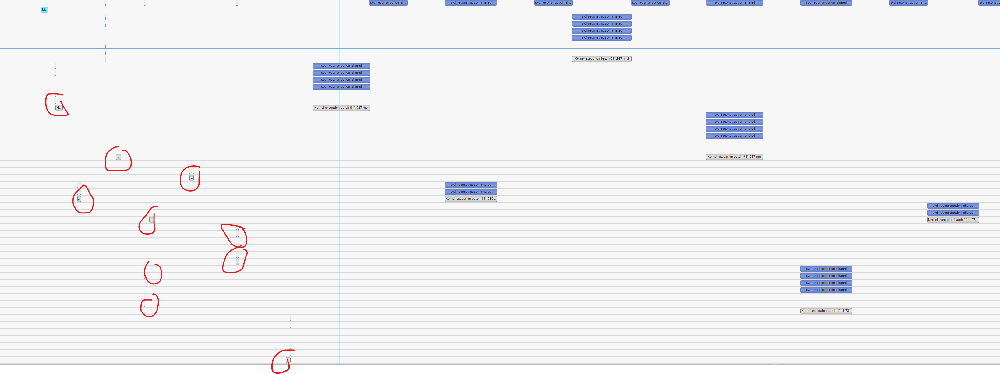

rot makiert H2D 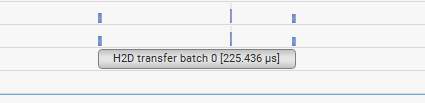

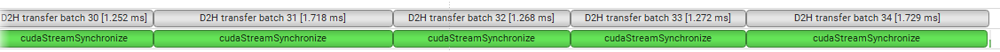

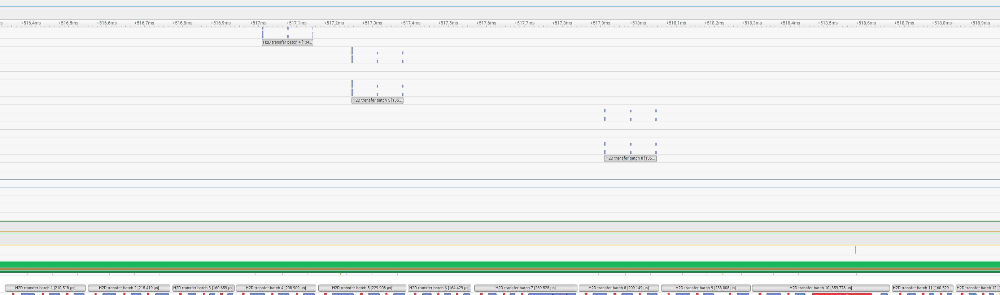

### Jetzt noch sicherstellen, dass alles Async läuft:

In [11]:
%%writefile experiment_nachtrag3.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit
from skimage.transform import resize

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

scale_factor = 5
def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)

def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory for the result
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, batch_size)

    # Create streams
    streams = [cp.cuda.Stream() for _ in range(batch_size)]

    u_gpus = []
    s_gpus = []
    vt_gpus = []

    # Asynchronous H2D transfers
    for i in range(batch_size):
        with streams[i]:
            nvtx.RangePush(f"H2D transfer batch {i}")
            u_gpus.append(cp.asarray(u_batch[i], dtype=cp.float32))
            s_gpus.append(cp.asarray(s_batch[i], dtype=cp.float32))
            vt_gpus.append(cp.asarray(vt_batch[i], dtype=cp.float32))
            nvtx.RangePop()

    # Kernel execution
    for i in range(batch_size):
        with streams[i]:
            nvtx.RangePush(f"Kernel execution batch {i}")
            reconstruct_svd_kernel(
                blocks_per_grid,
                threads_per_block,
                (u_gpus[i], s_gpus[i], vt_gpus[i], C_gpu[i], rows_u, cols_u, rows_vt, cols_vt, k),
            )
            nvtx.RangePop()

    # Asynchronous D2H transfers
    C_cpu = []
    for i in range(batch_size):
        with streams[i]:
            nvtx.RangePush(f"D2H transfer batch {i}")
            C_cpu.append(cp.asnumpy(C_gpu[i]))
            nvtx.RangePop()

    # Wait for all streams to finish
    cp.cuda.Stream.null.synchronize()

    # Convert list to numpy array
    C_cpu = np.array(C_cpu)
    
    return C_cpu

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([scale_image(imageio.imread(f), scale_factor) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (16, 16)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
#num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_nachtrag3.py


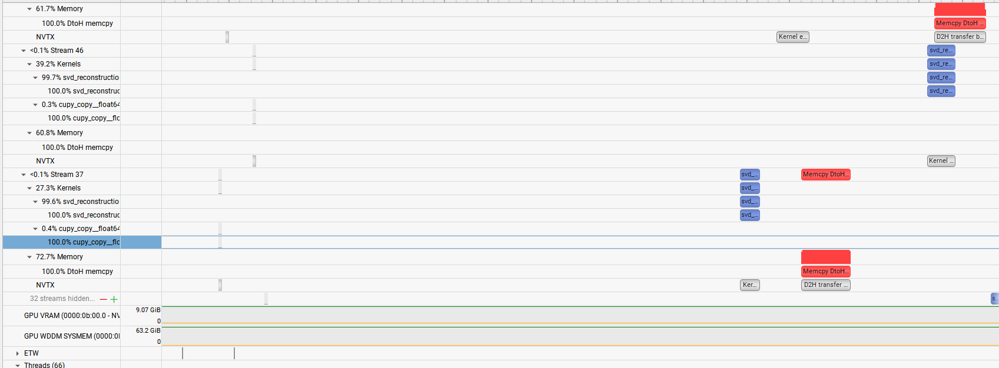

Ziel: 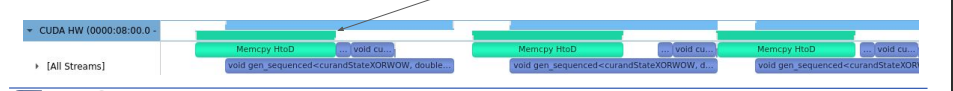
Overlapping computation.

Verbesserungen:
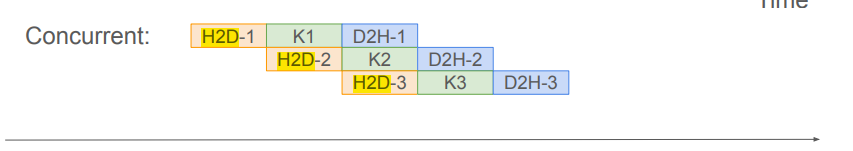

Die Overlappings und concurrency besser machen mit schönerem staggered.

at least i learned something today ;)

In [ ]:
!nsys profile --trace=cuda,nvtx -o profile_output python experiment_nachtrag.py

In [6]:
%%writefile experiment_nachtrag5.py

import cupy.cuda.runtime as cuda_runtime
import cupy.cuda.stream as cuda_stream
import cupy.cuda.nvtx as nvtx
import numpy as np
import cupy as cp
import time
import os
import glob
import imageio.v3 as imageio
from tqdm import tqdm
import matplotlib.pyplot as plt
import math
import timeit
from skimage.transform import resize

# Define the CUDA kernel code
kernel_code = """
extern "C" __global__
void svd_reconstruction_shared(const float* U, const float* S, const float* V, float* A, int M, int N, int K) {
    // Define the tile size
    const int TILE_SIZE = 32;

    // Shared memory arrays
    __shared__ float Us[TILE_SIZE][TILE_SIZE];
    __shared__ float Ss[TILE_SIZE];
    __shared__ float Vs[TILE_SIZE][TILE_SIZE];

    int tx = threadIdx.x, ty = threadIdx.y;
    int row = blockIdx.y * blockDim.y + ty;
    int col = blockIdx.x * blockDim.x + tx;
    float sum = 0.0f;

    // Loop over tiles
    for (int t = 0; t < (K + TILE_SIZE - 1) / TILE_SIZE; ++t) {
        int tiled_col = t * TILE_SIZE + tx;
        int tiled_row = t * TILE_SIZE + ty;

        // Load data into shared memory
        if (row < M && tiled_col < K) {
            Us[ty][tx] = U[row * K + tiled_col];
        } else {
            Us[ty][tx] = 0.0f;
        }

        if (ty == 0 && tiled_col < K) {
            Ss[tx] = S[tiled_col];
        }

        if (col < N && tiled_row < K) {
            Vs[ty][tx] = V[tiled_row * N + col];
        } else {
            Vs[ty][tx] = 0.0f;
        }
        __syncthreads();

        // Compute the dot product
        #pragma unroll
        for (int k = 0; k < TILE_SIZE; ++k) {
            sum += Us[ty][k] * Ss[k] * Vs[k][tx];
        }
        __syncthreads();
    }

    // Write the result
    if (row < M && col < N) {
        A[row * N + col] = sum;
    }
}
"""

reconstruct_svd_kernel = cp.RawKernel(kernel_code, "svd_reconstruction_shared")

scale_factor = 5
def scale_image(image, scale_factor):
    new_shape = tuple(int(dim * scale_factor) for dim in image.shape)
    return resize(image, new_shape, mode="reflect", anti_aliasing=True)

def reconstruct_svd_batch_gpu(u_batch, s_batch, vt_batch, k, block_size):
    batch_size, rows_u, cols_u = u_batch.shape
    rows_vt, cols_vt = vt_batch.shape[1:]

    # Allocate GPU memory for the result
    C_gpu = cp.zeros((batch_size, rows_u, cols_vt), dtype=cp.float32)

    # Configure kernel execution parameters
    threads_per_block = (block_size[0], block_size[1])
    blocks_per_grid_x = math.ceil(rows_u / threads_per_block[0])
    blocks_per_grid_y = math.ceil(cols_vt / threads_per_block[1])
    blocks_per_grid_z = batch_size
    blocks_per_grid = (blocks_per_grid_x, blocks_per_grid_y, blocks_per_grid_z)

    # Create streams
    streams = [cp.cuda.Stream() for _ in range(batch_size)]

    # Launch kernel in each stream with async H2D memory transfers
    for i in range(batch_size):
        with streams[i]:
            # Start NVTX range for the H2D transfer
            nvtx.RangePush(f"H2D transfer batch {i}")

            # Asynchronous H2D transfer
            u_gpu = cp.asarray(u_batch[i], dtype=cp.float32)
            s_gpu = cp.asarray(s_batch[i], dtype=cp.float32)
            vt_gpu = cp.asarray(vt_batch[i], dtype=cp.float32)

            # End NVTX range for the H2D transfer
            nvtx.RangePop()

            # Start NVTX range for the kernel execution
            nvtx.RangePush(f"Kernel execution batch {i}")

            # Launch the kernel
            reconstruct_svd_kernel(
                blocks_per_grid,
                threads_per_block,
                (u_gpu.data.ptr, s_gpu.data.ptr, vt_gpu.data.ptr, C_gpu[i].data.ptr, rows_u, cols_u, rows_vt, cols_vt, k),
                stream=streams[i]
            )

            # End NVTX range for the kernel execution
            nvtx.RangePop()

            # Start NVTX range for the D2H transfer
            nvtx.RangePush(f"D2H transfer batch {i}")

            # Asynchronous D2H transfer
            cp.asnumpy(C_gpu[i], stream=streams[i])

            # End NVTX range for the D2H transfer
            nvtx.RangePop()

    # Wait for all streams to finish
    for stream in streams:
        stream.synchronize()

    # Copy result back to CPU
    return cp.asnumpy(C_gpu)

def load_images_and_compute_svd(folder, pattern="*.png"):
    files = sorted(glob.glob(os.path.join(folder, pattern)))
    images = np.array([scale_image(imageio.imread(f), scale_factor) for f in tqdm(files, desc="Loading images")])
    svd_results = [cp.linalg.svd(cp.asarray(im), full_matrices=False) for im in images]
    u_batch = cp.array([u[:, :17] for u, s, vt in svd_results])
    s_batch = cp.array([s[:17] for u, s, vt in svd_results])
    vt_batch = cp.array([vt[:17, :] for u, s, vt in svd_results])
    return images, u_batch, s_batch, vt_batch

# Load images and compute SVD
subfolder = "001"
images, u_batch, s_batch, vt_batch = load_images_and_compute_svd(
    os.path.join("adni_png", subfolder)
)

# Perform batch SVD reconstruction on GPU
block_size = (16, 16)
start_time = timeit.default_timer()
reconstructed_images = reconstruct_svd_batch_gpu(
    u_batch, s_batch, vt_batch, 17, block_size
)
end_time = timeit.default_timer()

# Display all original and reconstructed images
num_images = len(images)
#fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

#for i in range(num_images):
#    axes[i, 0].imshow(images[i], cmap='gray')
#    axes[i, 0].set_title(f"Original Image {i + 1}")
#    axes[i, 1].imshow(reconstructed_images[i], cmap='gray')
#    axes[i, 1].set_title(f"Reconstructed Image {i + 1}")

#plt.tight_layout()
#plt.show()

# Print benchmarking results
print(f"Reconstruction time: {end_time - start_time:.2f} seconds")


Overwriting experiment_nachtrag5.py


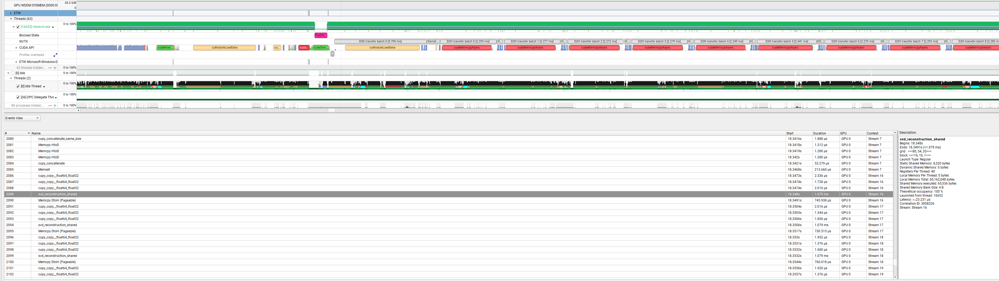
